# Pothole detection using VGG

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np 
import pandas as pd 
from tqdm import tqdm
from keras import models, layers
import keras
from keras.utils import np_utils
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras.callbacks import ReduceLROnPlateau
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam

import warnings
warnings.filterwarnings('always')
warnings.filterwarnings('ignore')


import matplotlib.pyplot as plt
from matplotlib import style

import cv2
import random as rn
import os

In [ ]:
X = []
TEMP = []
projectDir = '/content/drive/MyDrive/MACS/6505/Project'
IMG_SIZE = 224
nImagesOrg = projectDir + "/assets/normal/"
pImagesOrg = projectDir + "/assets/potholes/"

**"Data Preprocessing"**

In [ ]:
def process_data(label,DIR):
    for img in tqdm(os.listdir(DIR)):
        try:
            path = os.path.join(DIR,img)
            img = cv2.imread(path,cv2.IMREAD_COLOR)
            img = cv2.resize(img, (IMG_SIZE,IMG_SIZE))

            X.append(np.array(img))
            TEMP.append(str(label))
        except:
            pass

In [ ]:
process_data('NORMAL',nImagesOrg)

100%|██████████| 352/352 [02:29<00:00,  2.35it/s]


In [ ]:
process_data('POTHOLE',pImagesOrg)

100%|██████████| 329/329 [02:39<00:00,  2.06it/s]


**"Data Visualization"**

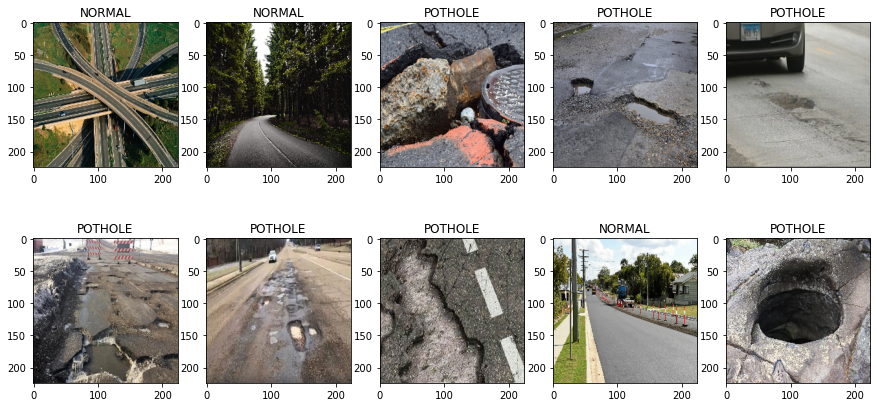

In [ ]:
fig,ax = plt.subplots(2,5)
plt.subplots_adjust(bottom=0.3, top=0.7, hspace=0)
fig.set_size_inches(15,15)

for i in range(2):
    for j in range (5):
        l = rn.randint(0,len(TEMP)-1)
        ax[i,j].imshow(X[l][:,:,::-1])
        ax[i,j].set_title(TEMP[l])
        ax[i,j].set_aspect('equal')

**Converting categorical values to one-hot encoding format using LabelEncoder()**

In [ ]:
label_encoder = LabelEncoder()
Y = label_encoder.fit_transform(TEMP)
Y = to_categorical(Y,2)
print(Y)
X = np.array(X)
X = X/255
X_train,X_test,y_train,y_test = train_test_split(X,Y,test_size=0.25,random_state=0)

[[1. 0.]
 [1. 0.]
 [1. 0.]
 ...
 [0. 1.]
 [0. 1.]
 [0. 1.]]


In [ ]:
type(X_test)

numpy.ndarray

In [ ]:
X_test.shape

(170, 224, 224, 3)

In [ ]:
label_encoder.transform(["NORMAL","POTHOLE"])

array([0, 1])

In [ ]:
y_train.sum(axis=0),y_test.sum(axis=0)

(array([267., 243.], dtype=float32), array([84., 86.], dtype=float32))

In [ ]:
X_train.shape

(510, 224, 224, 3)

**To reduce learning rate while training the model**

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_accuracy', 
                                patience=3, 
                                verbose=1, 
                                factor=0.2, 
                                min_lr=1e-6)

In [ ]:
data_generator = ImageDataGenerator(
            rotation_range=10, 
            width_shift_range=0.1, 
            height_shift_range=0.1, 
            shear_range=0.1,
            zoom_range=0.2)
data_generator.fit(X_train) 

**VGG model**

In [ ]:
class VGGNet(models.Sequential):
    def __init__(self, input_shape, num_classes):
        super().__init__()

        self.add(layers.Conv2D(32, kernel_size=(5, 5), activation='elu', kernel_regularizer="l2", input_shape=input_shape, padding="same"))
        self.add(layers.Conv2D(32, kernel_size=(5, 5), activation='elu', kernel_regularizer="l2", input_shape=input_shape, padding="same"))
        self.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
        self.add(layers.Conv2D(64, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(64, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.Conv2D(128, kernel_size=(3,3), kernel_regularizer="l2", padding='same',activation='elu'))
        self.add(layers.MaxPool2D(pool_size=(2,2),strides=(2,2)))
        self.add(layers.Flatten())
        self.add(Dropout(0.3))
        self.add(layers.Dense(128, activation='elu',kernel_regularizer="l2"))
        self.add(layers.Dense(128, activation='elu',kernel_regularizer="l2"))
        self.add(layers.Dense(num_classes,kernel_regularizer="l2"))
        self.add(layers.Activation("softmax"))

        self.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer=Adam(lr=5e-4))

In [ ]:
from keras.layers import Dropout
input_shape = (224, 224, 3)
num_classes = 2
batch_size = 12
epoch = 29
model = VGGNet(input_shape, num_classes)

In [ ]:
model_history = model.fit_generator(data_generator.flow(X_train, y_train, batch_size=12), steps_per_epoch=len(X_train)/12, 
                    epochs=29, validation_data=(X_test, y_test), callbacks=[reduce_lr])
test_score = model.evaluate(X_test, y_test, batch_size=batch_size)
print()
print('Test loss:', test_score[0]) 
print('Test accuracy:', test_score[1])

Epoch 1/29
42/42 [==============================] - 12s 206ms/step - loss: 16.7025 - accuracy: 0.4844 - val_loss: 14.4448 - val_accuracy: 0.6824
Epoch 2/29
42/42 [==============================] - 6s 150ms/step - loss: 13.8018 - accuracy: 0.6610 - val_loss: 11.8498 - val_accuracy: 0.7294
Epoch 3/29
42/42 [==============================] - 6s 149ms/step - loss: 11.3473 - accuracy: 0.7307 - val_loss: 9.5254 - val_accuracy: 0.8588
Epoch 4/29
42/42 [==============================] - 6s 151ms/step - loss: 9.0970 - accuracy: 0.8209 - val_loss: 7.6569 - val_accuracy: 0.8765
Epoch 5/29
42/42 [==============================] - 6s 151ms/step - loss: 7.3255 - accuracy: 0.8236 - val_loss: 6.0902 - val_accuracy: 0.8824
Epoch 6/29
42/42 [==============================] - 6s 149ms/step - loss: 5.8641 - accuracy: 0.8447 - val_loss: 4.9354 - val_accuracy: 0.8706
Epoch 7/29
42/42 [==============================] - 6s 152ms/step - loss: 4.7311 - accuracy: 0.8566 - val_loss: 4.0399 - val_accuracy: 0.8235


In [ ]:
def plot_accuracy(history):
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('Model Accuracy')
  plt.ylabel('Accuracy')
  plt.xlabel('epoch')
  plt.legend(['Train', 'Validation'], loc='upper left')
  plt.show()

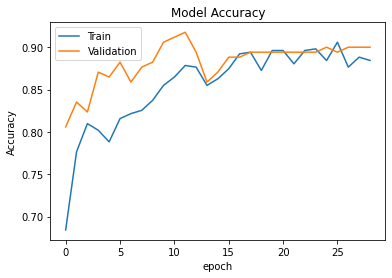

In [ ]:
plot_accuracy(model_history)
plt.show()

In [ ]:
def plot_loss(history):
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Model Loss')
  plt.ylabel('Loss')
  plt.xlabel('epoch')
  plt.legend(['Train', 'Validation'], loc='upper left')
  plt.show()

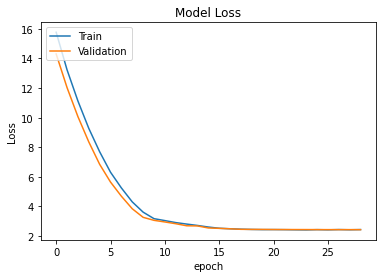

In [ ]:
plot_loss(model_history)
plt.show()

In [ ]:
t=np.random.randn(1,224,224,3)
keras.models.Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)(t),model(t)

(<tf.Tensor: shape=(1, 2), dtype=float32, numpy=array([[-0.89689445,  0.5844573 ]], dtype=float32)>,
 <tf.Tensor: shape=(1, 2), dtype=float32, numpy=array([[0.18522334, 0.81477666]], dtype=float32)>)

In [ ]:
import tensorflow as tf
import keras.backend as K
K.set_learning_phase(0)
logits = keras.models.Model(inputs=model.layers[0].input,outputs=model.layers[-2].output)
def visualize():
  print("Random Train Example")
  idx = rn.randint(0,len(X_train)-1)
  x_var = K.variable(X_train[idx:idx+1])
  with tf.GradientTape() as tape:
    tape.watch(x_var)
    y = tf.reduce_sum(logits(x_var)[:,label_encoder.transform(["POTHOLE"]).item()],axis=0)
  print(y)
  plt.axis("off")
  plt.imshow(x_var[0])
  plt.show()
  mask = tape.gradient(y,x_var)[0]
  plt.imshow(tf.reduce_sum(mask,axis=2))
  plt.show()

  print("Random Test Example")
  idx = rn.randint(0,len(X_test)-1)
  x_var = K.variable(X_test[idx:idx+1])
  with tf.GradientTape() as tape:
    tape.watch(x_var)
    y = tf.reduce_sum(logits(x_var)[:,label_encoder.transform(["POTHOLE"]).item()],axis=0)
  print(y)
  plt.axis("off")
  plt.imshow(x_var[0])
  plt.show()
  mask = tape.gradient(y,x_var)[0]
  plt.imshow(tf.reduce_sum(mask,axis=2))
  plt.show()

Random Train Example
tf.Tensor(-2.84076, shape=(), dtype=float32)


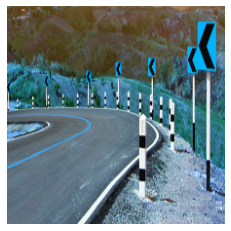

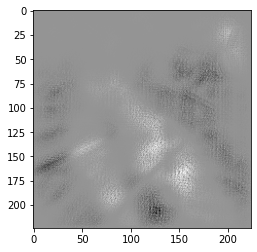

Random Test Example
tf.Tensor(0.9451564, shape=(), dtype=float32)


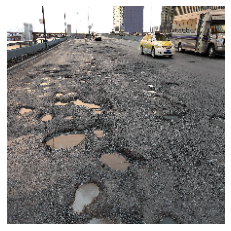

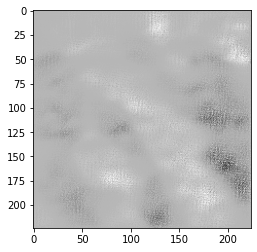

In [ ]:
visualize()

In [ ]:
visualize()

In [ ]:
!pip install keract

In [ ]:
from keract import get_activations, display_activations
test_input = X_test[5:6]
activation_output = get_activations(model, test_input)

conv2d_input (1, 224, 224, 3) 


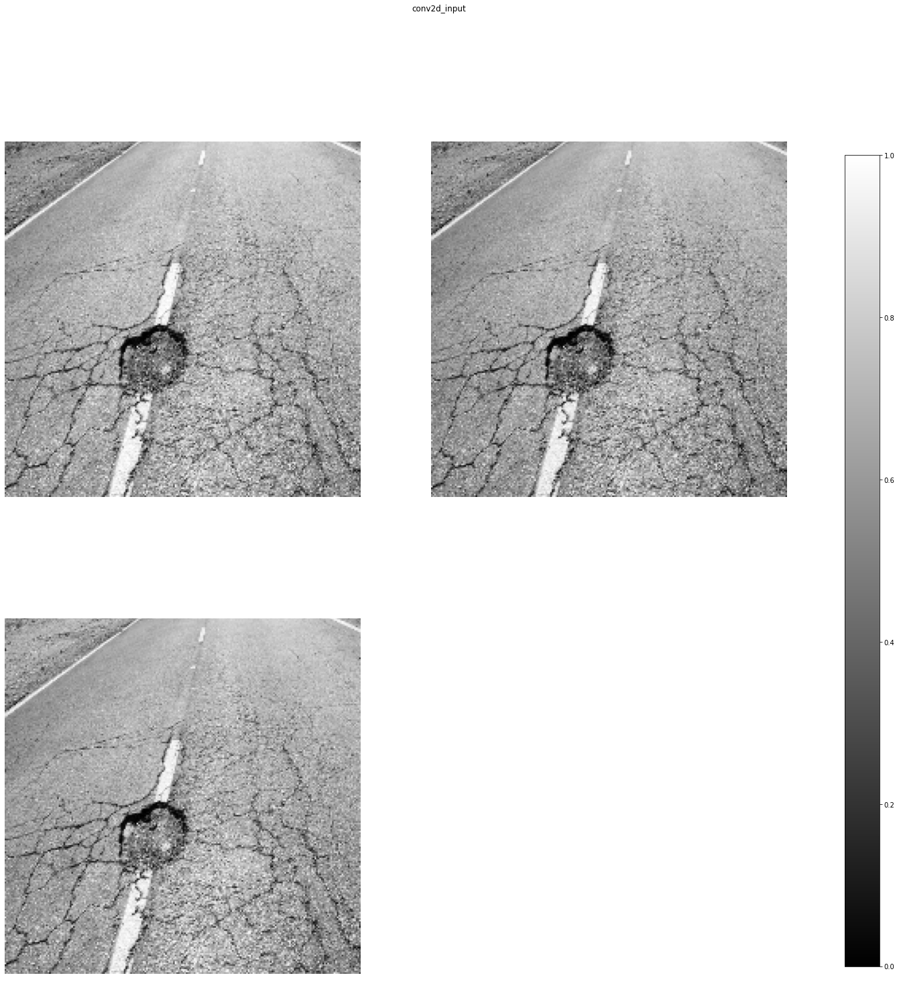

conv2d (1, 224, 224, 32) 


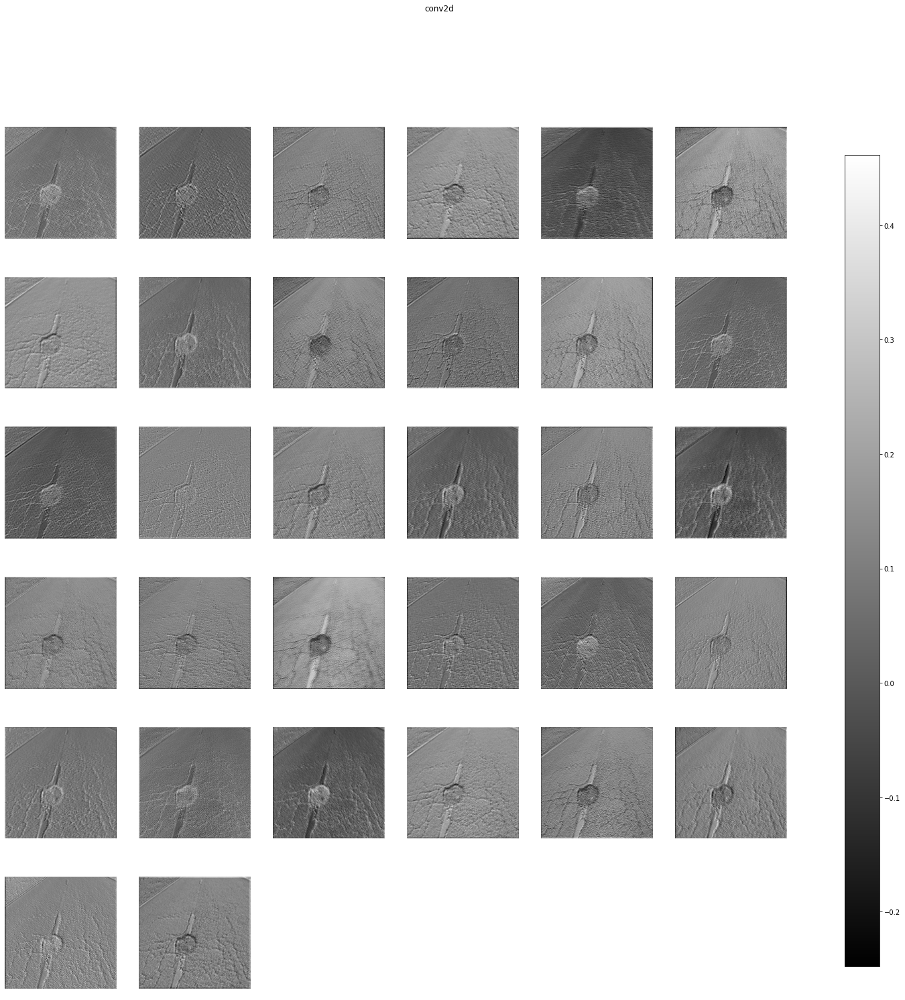

conv2d_1 (1, 224, 224, 32) 


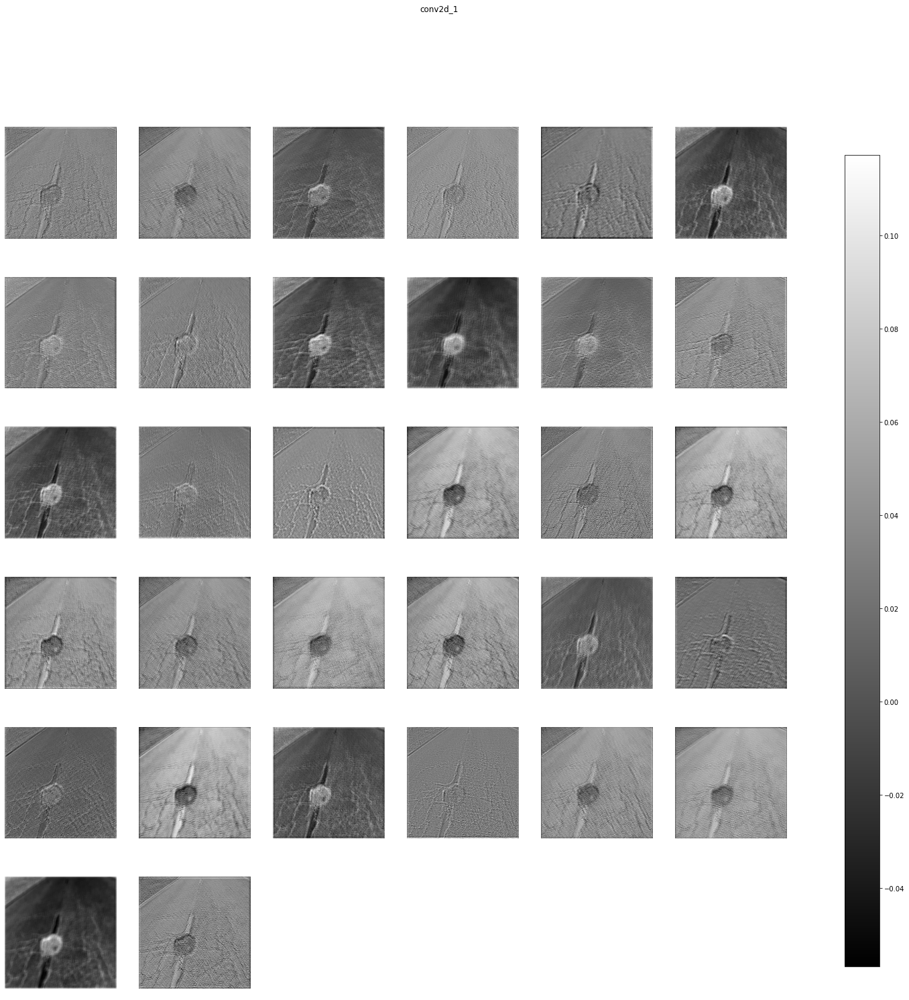

max_pooling2d (1, 112, 112, 32) 


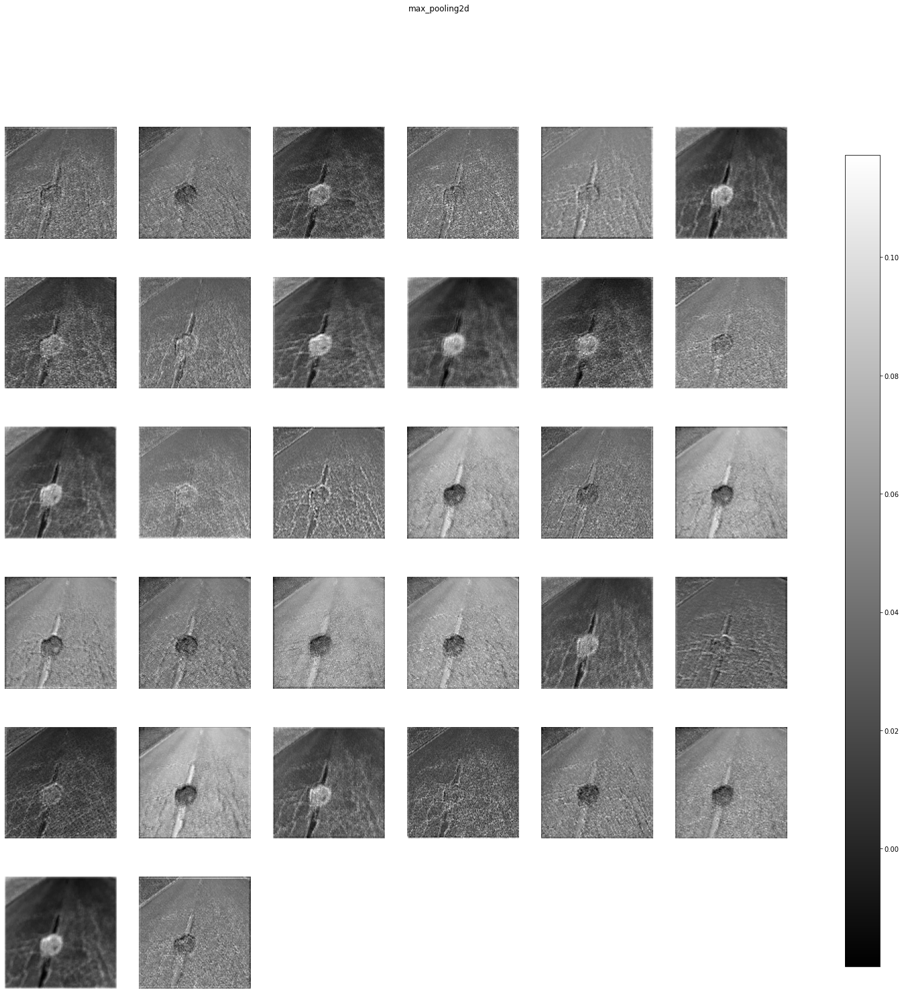

conv2d_2 (1, 112, 112, 64) 


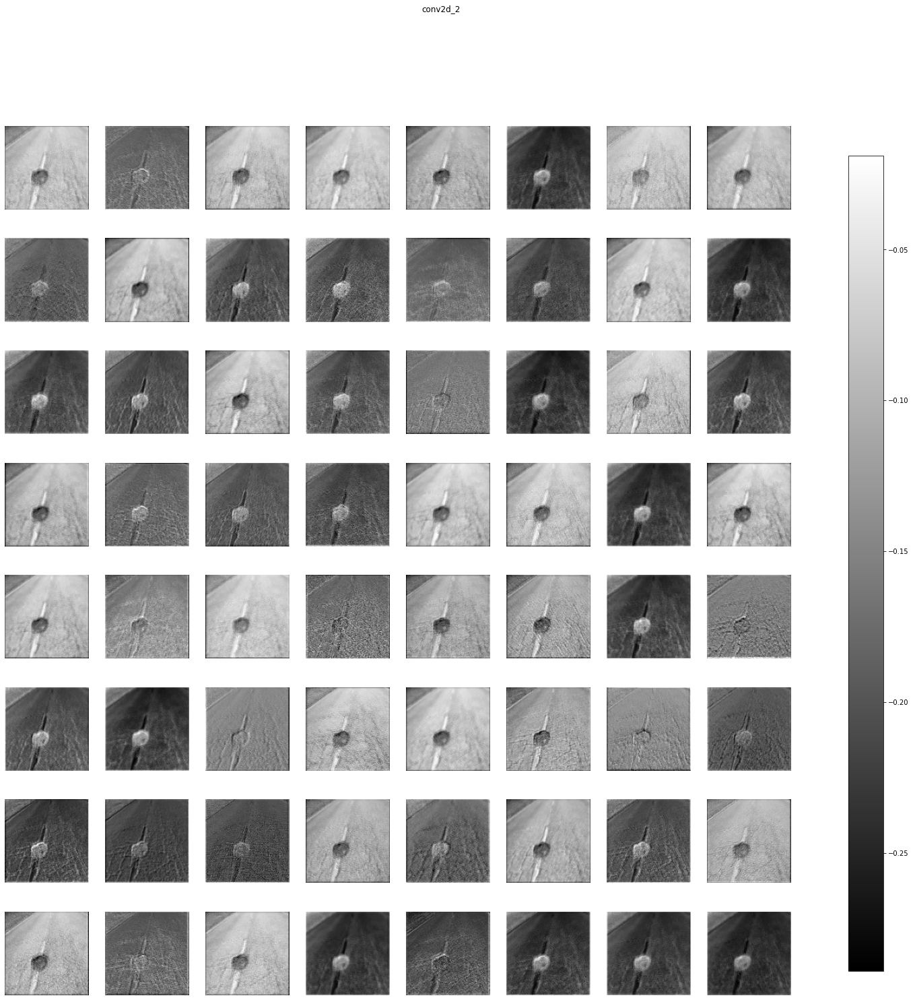

conv2d_3 (1, 112, 112, 64) 


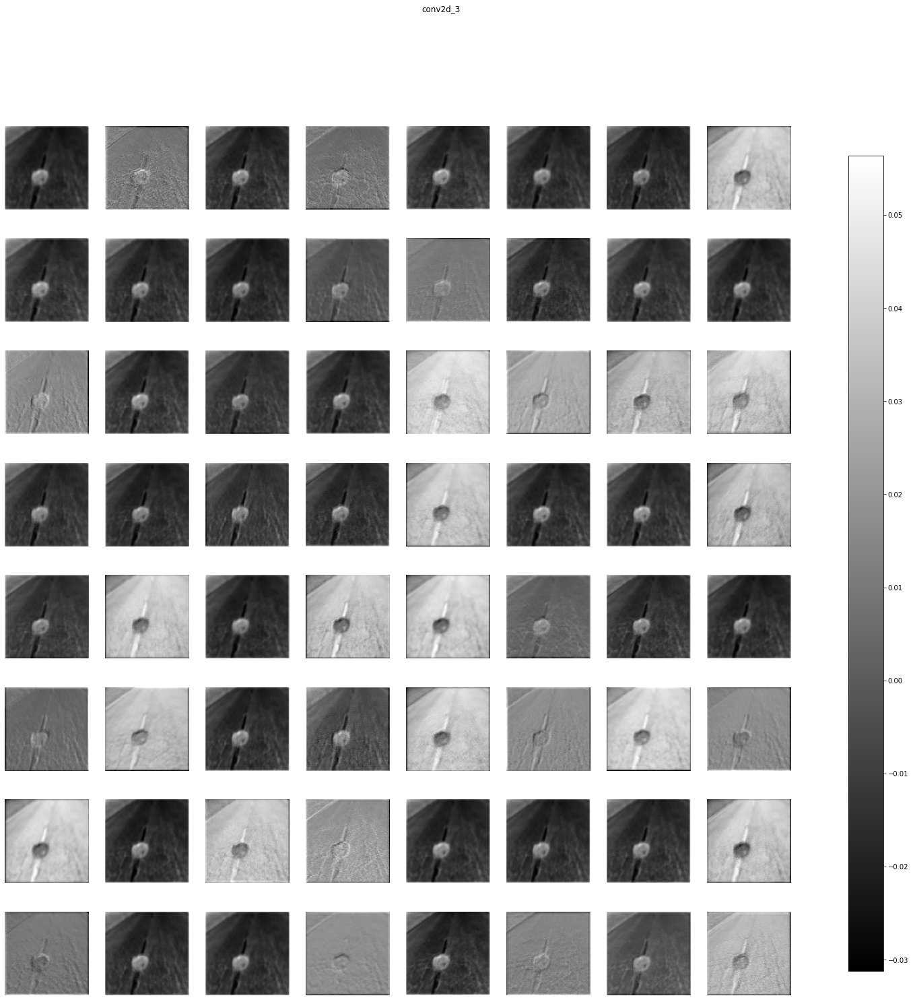

max_pooling2d_1 (1, 56, 56, 64) 


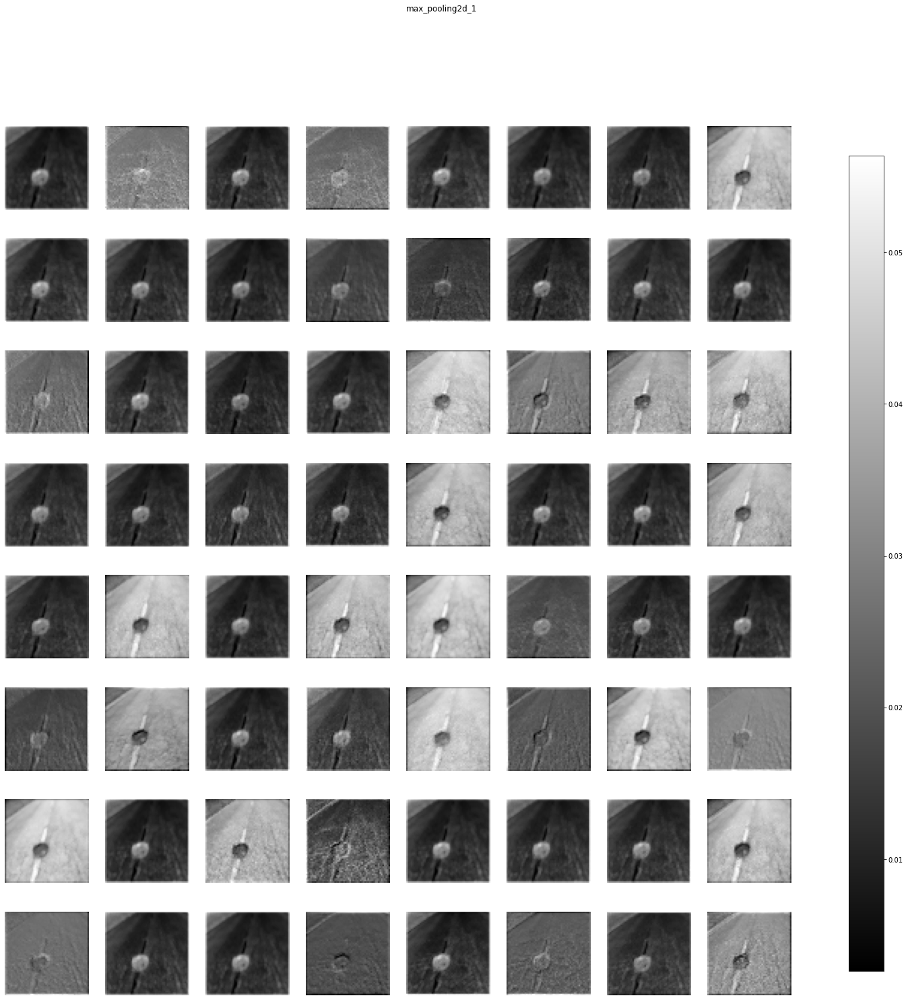

conv2d_4 (1, 56, 56, 128) 


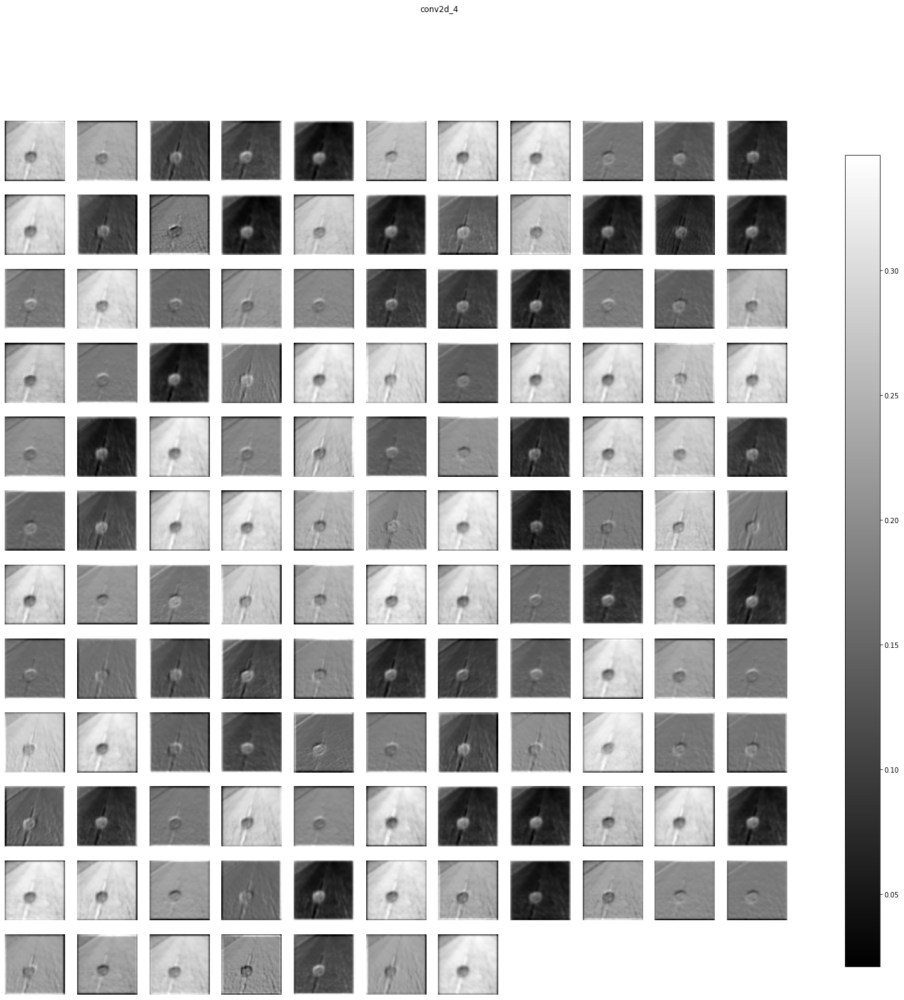

conv2d_5 (1, 56, 56, 128) 


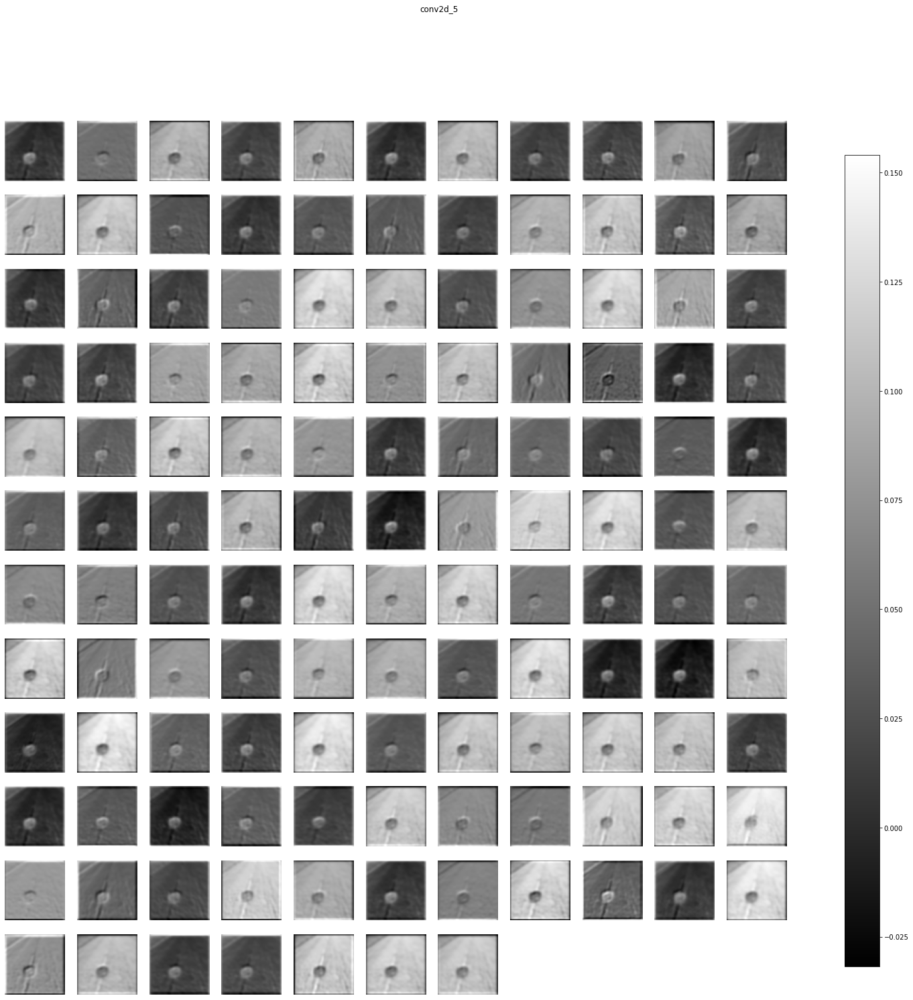

conv2d_6 (1, 56, 56, 128) 


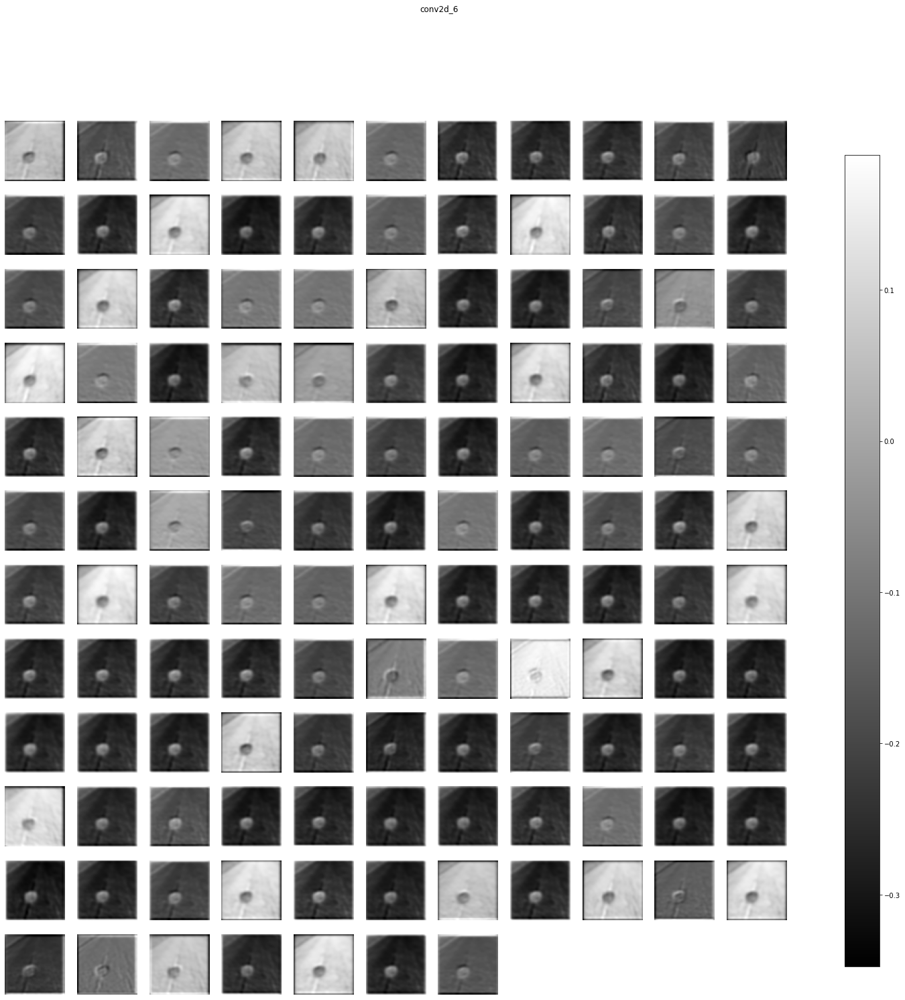

max_pooling2d_2 (1, 28, 28, 128) 


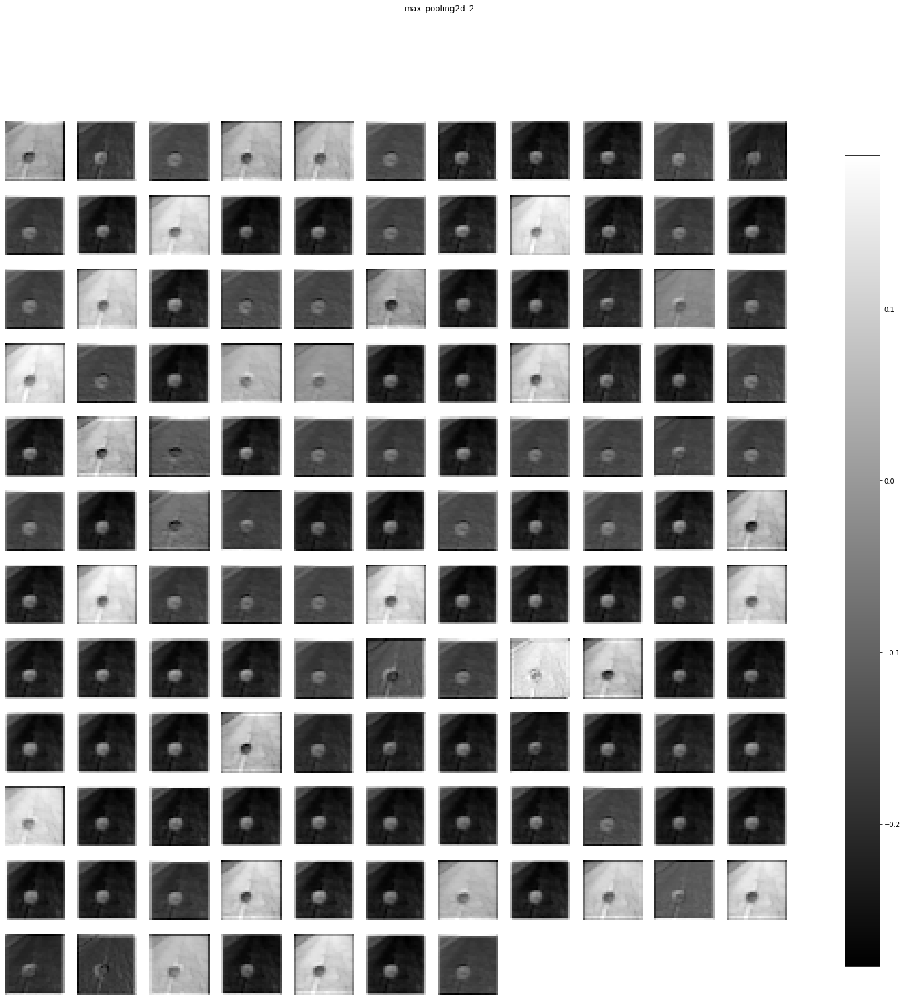

conv2d_7 (1, 28, 28, 128) 


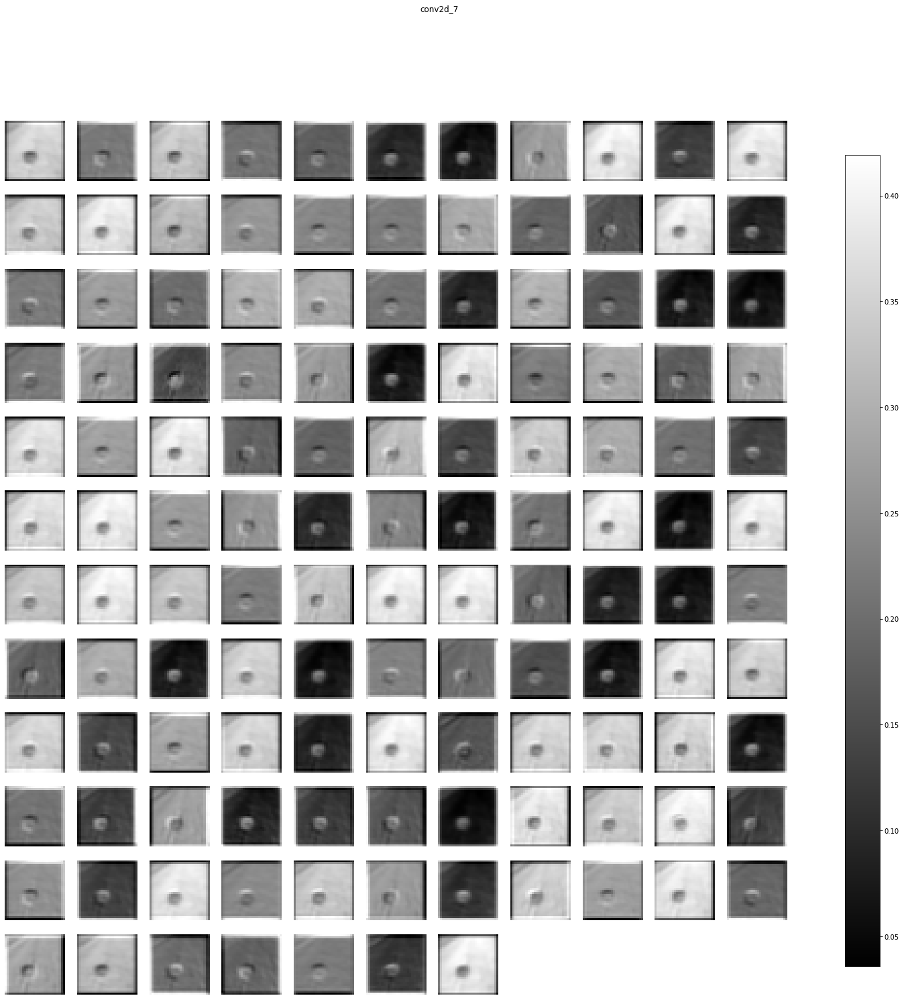

conv2d_8 (1, 28, 28, 128) 


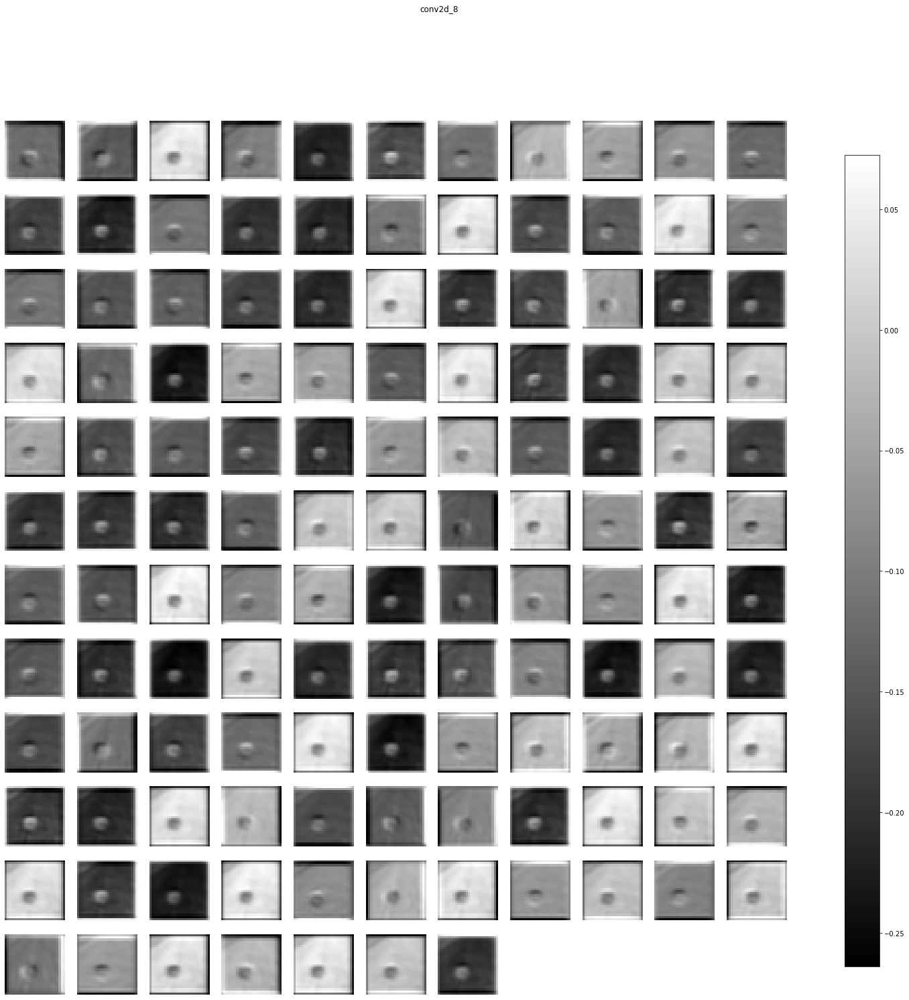

conv2d_9 (1, 28, 28, 128) 


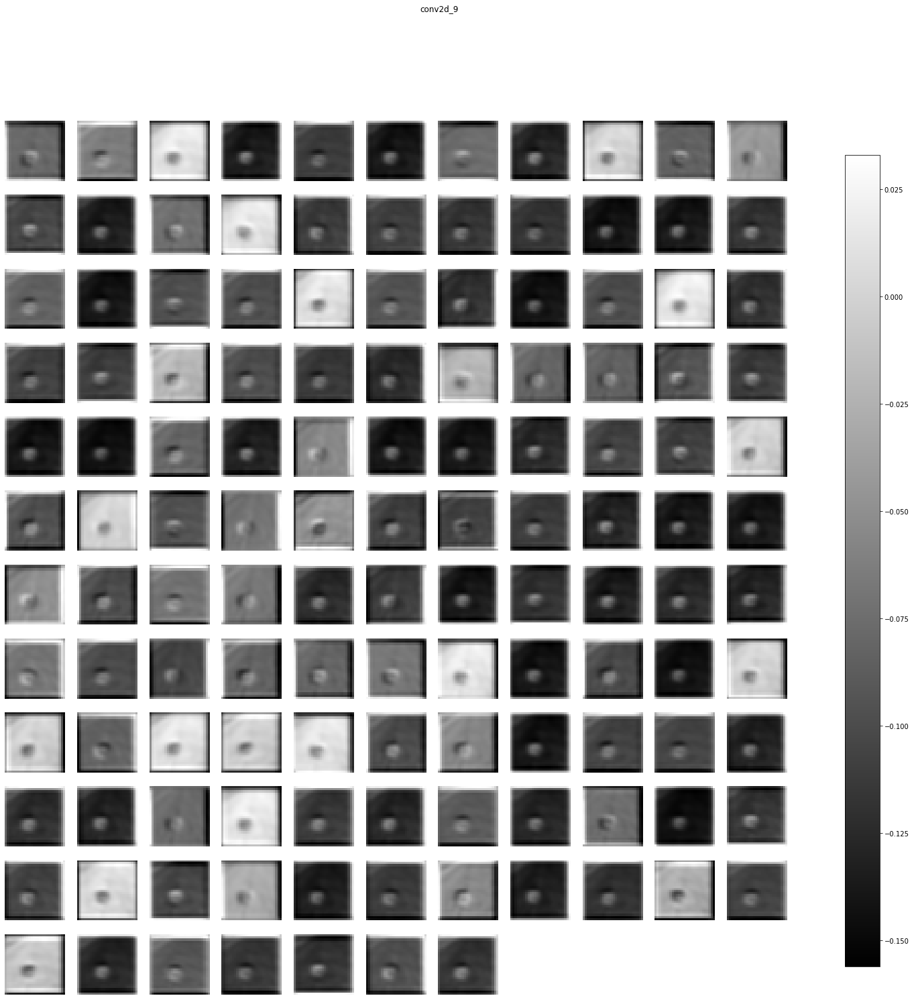

max_pooling2d_3 (1, 14, 14, 128) 


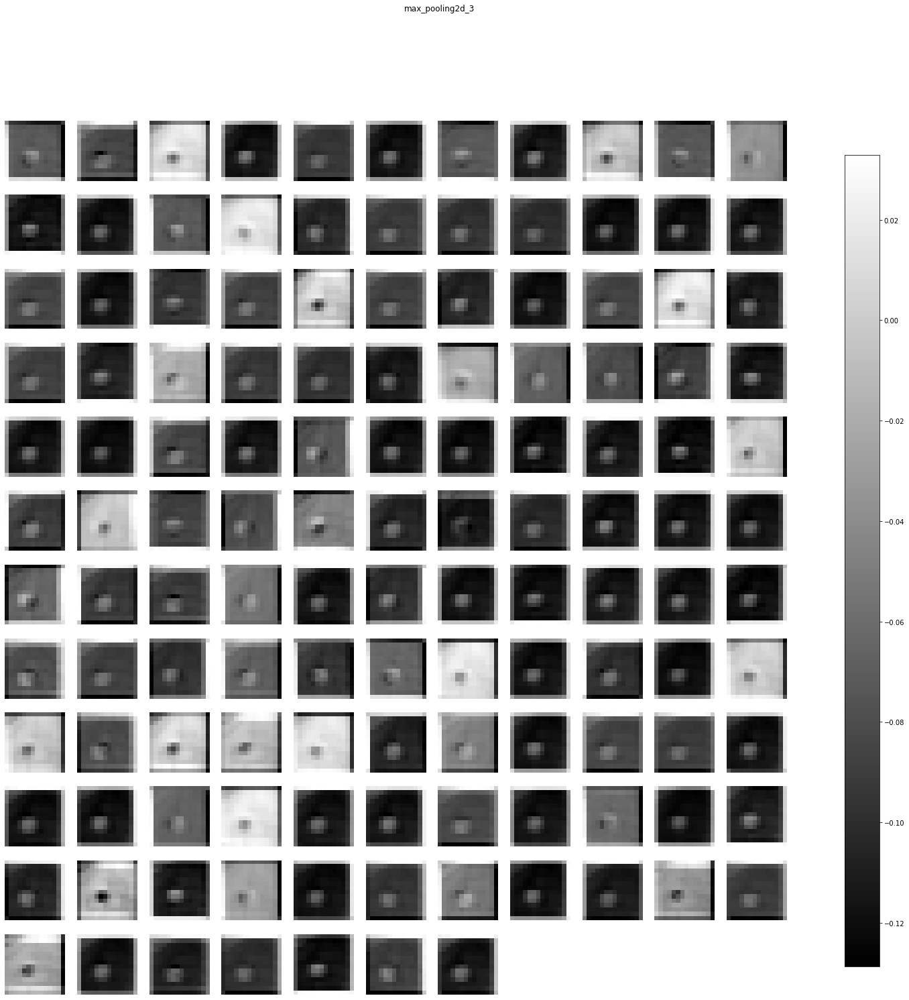

conv2d_10 (1, 14, 14, 128) 


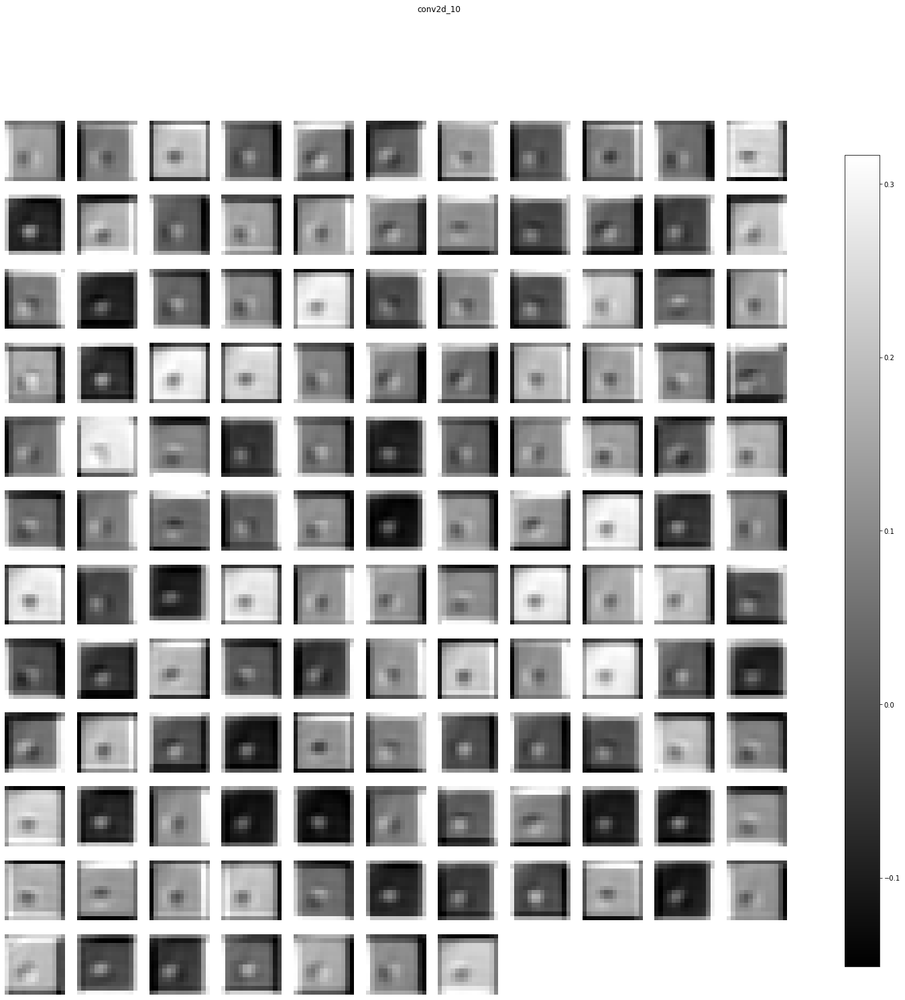

conv2d_11 (1, 14, 14, 128) 


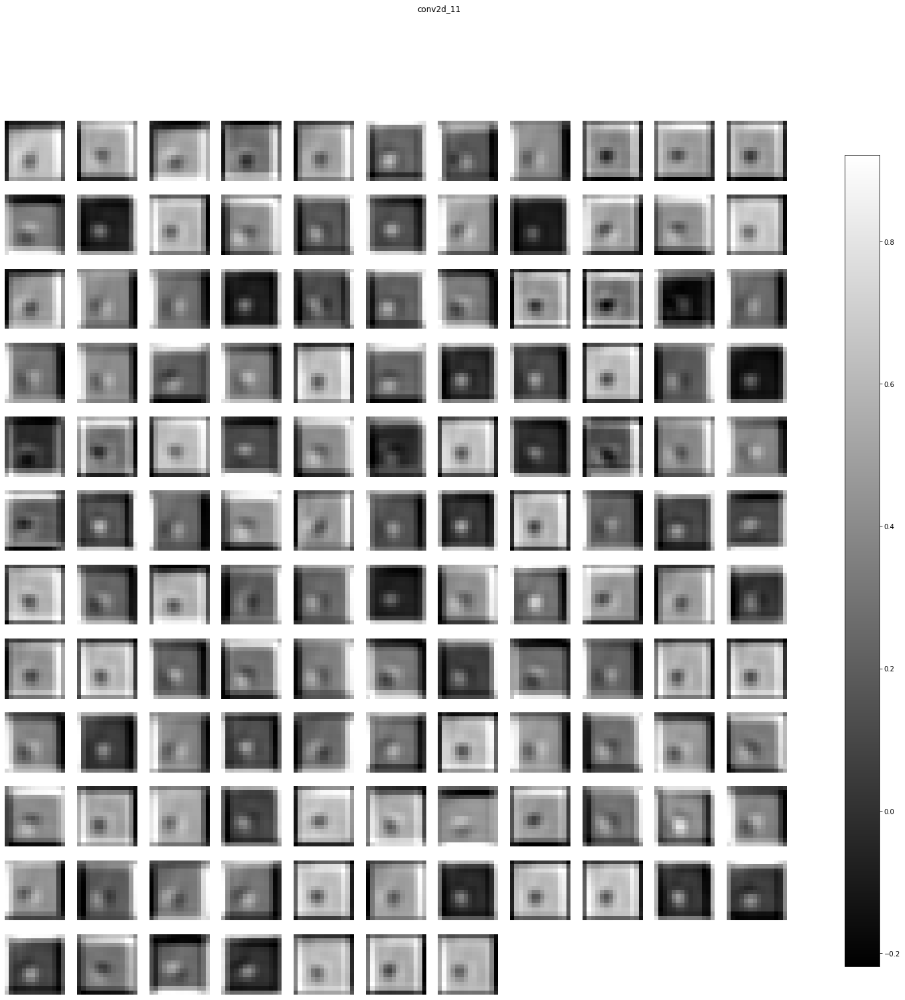

conv2d_12 (1, 14, 14, 128) 


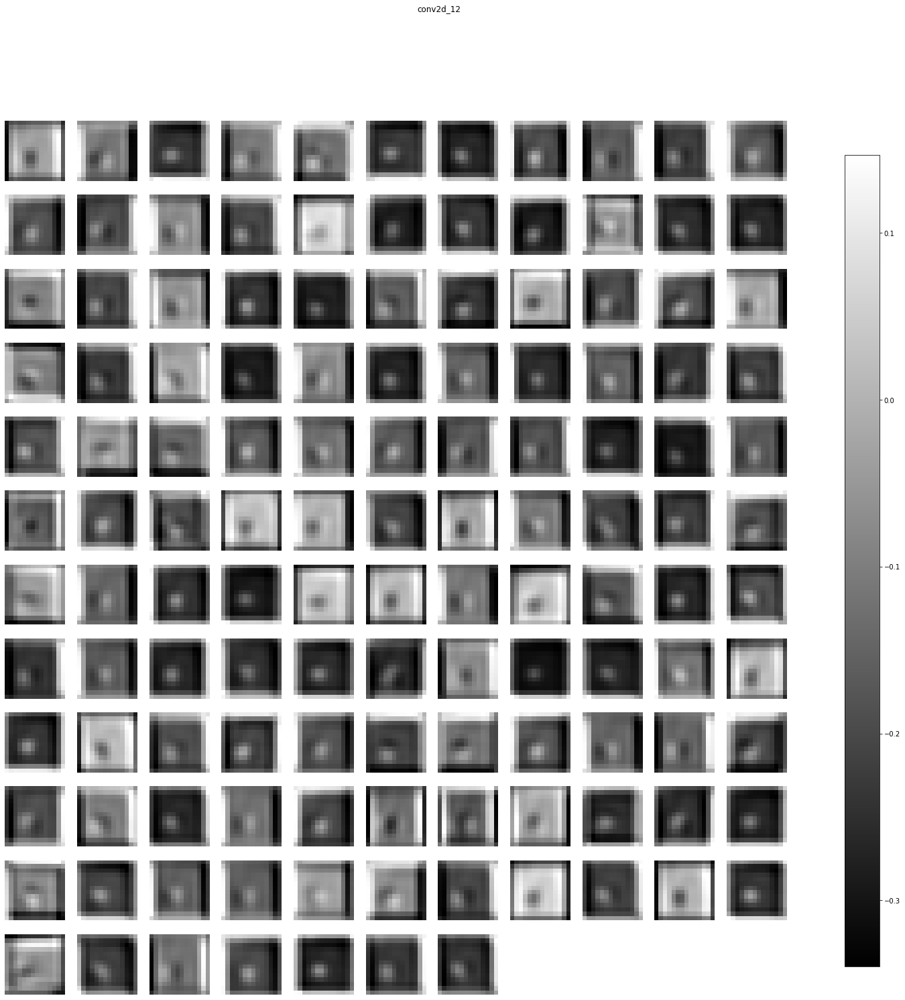

max_pooling2d_4 (1, 7, 7, 128) 


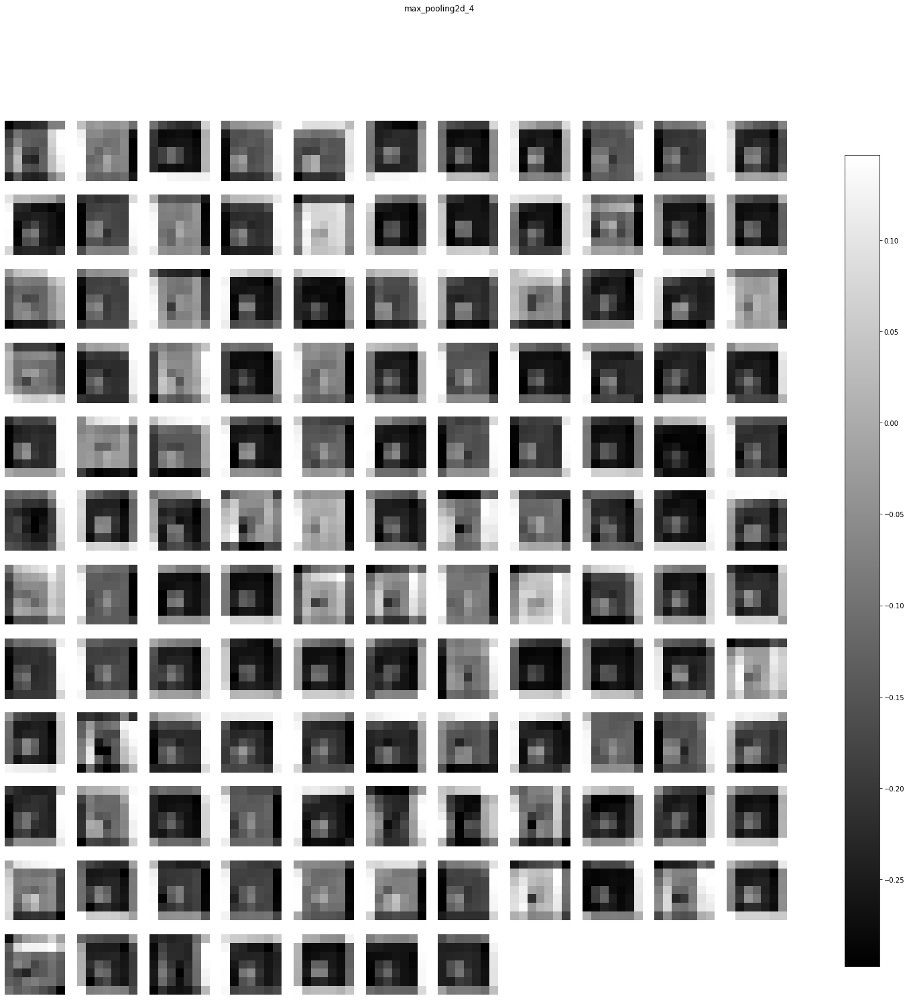

flatten (1, 6272) 


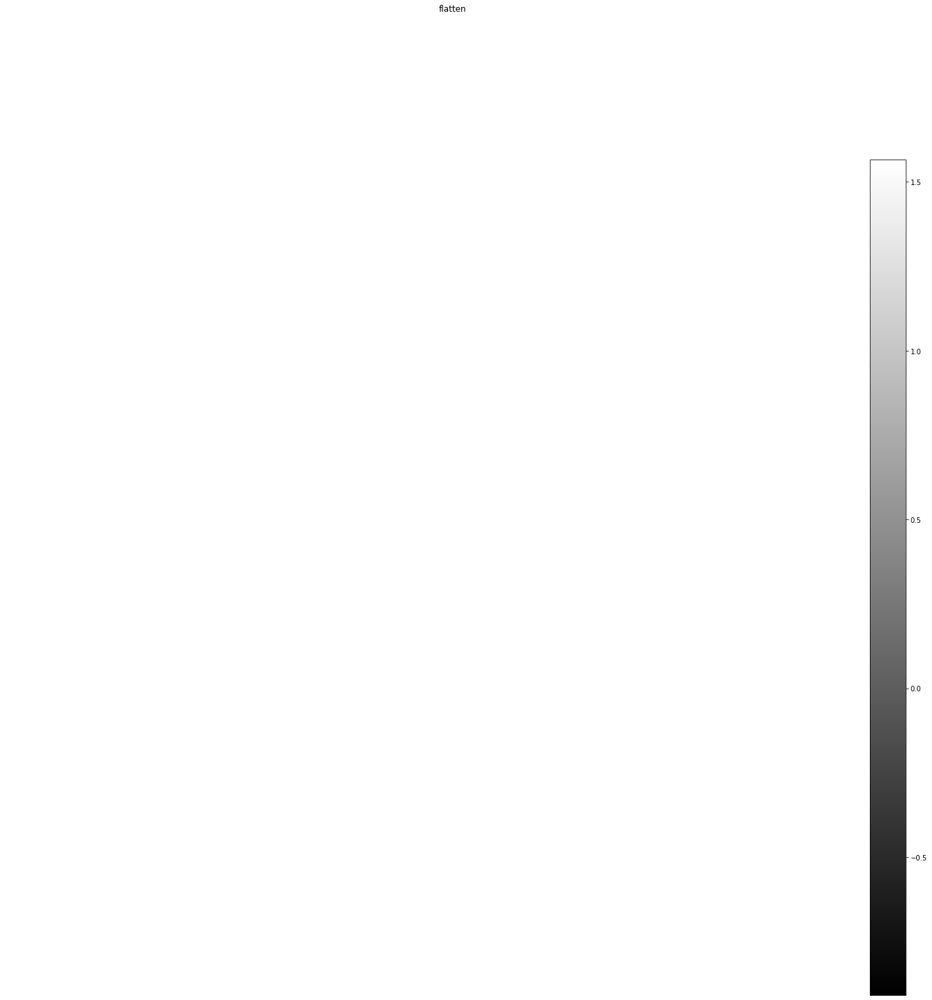

dropout (1, 6272) 


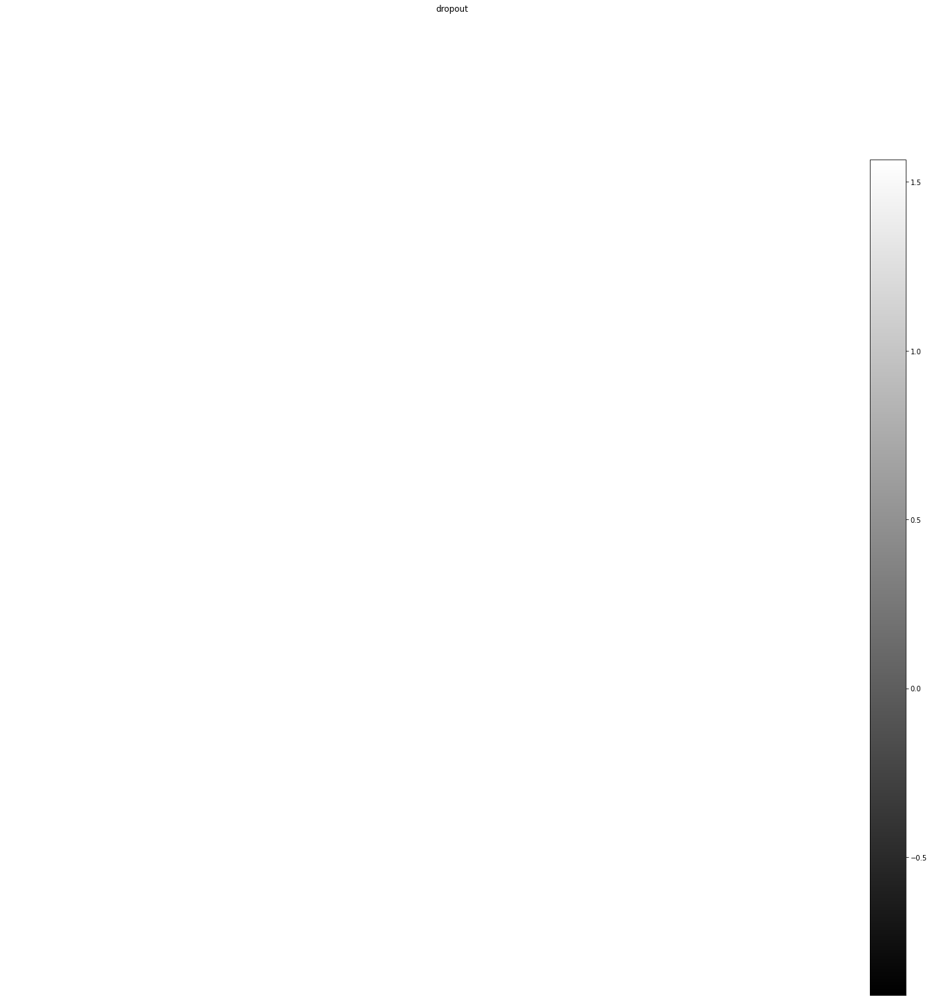

dense (1, 128) 


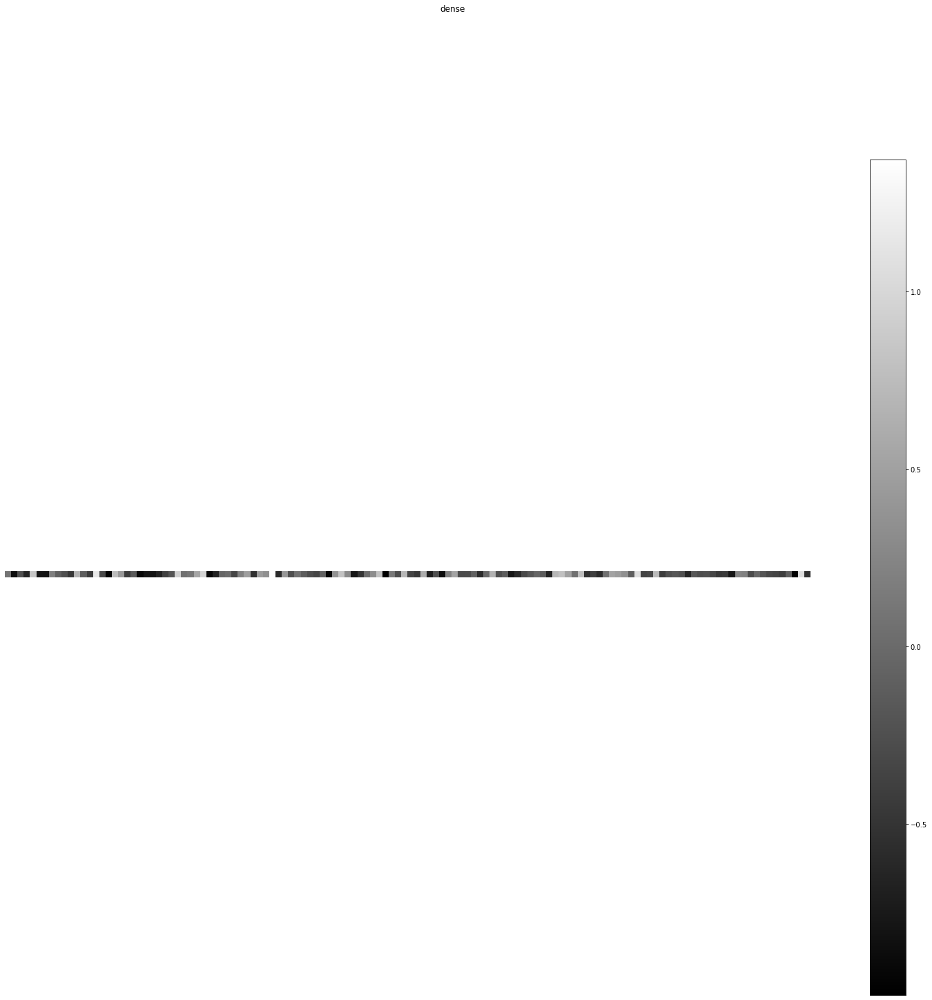

dense_1 (1, 128) 


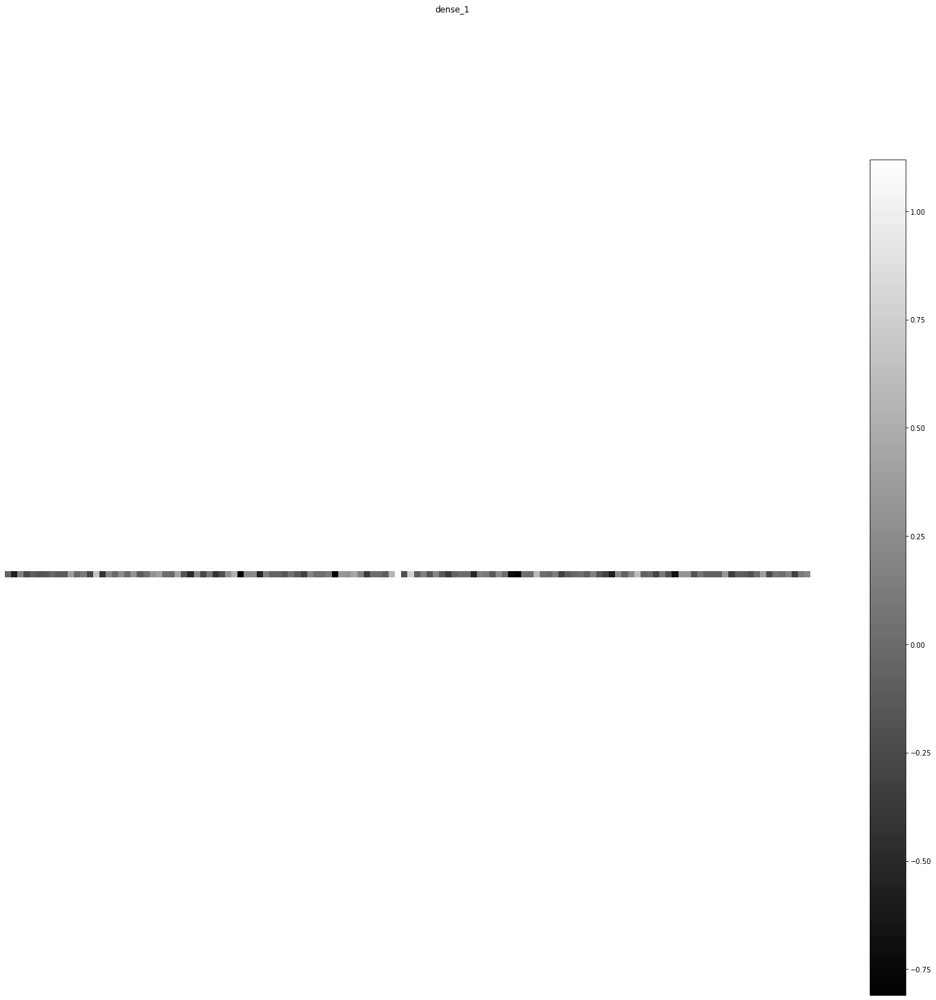

dense_2 (1, 2) 


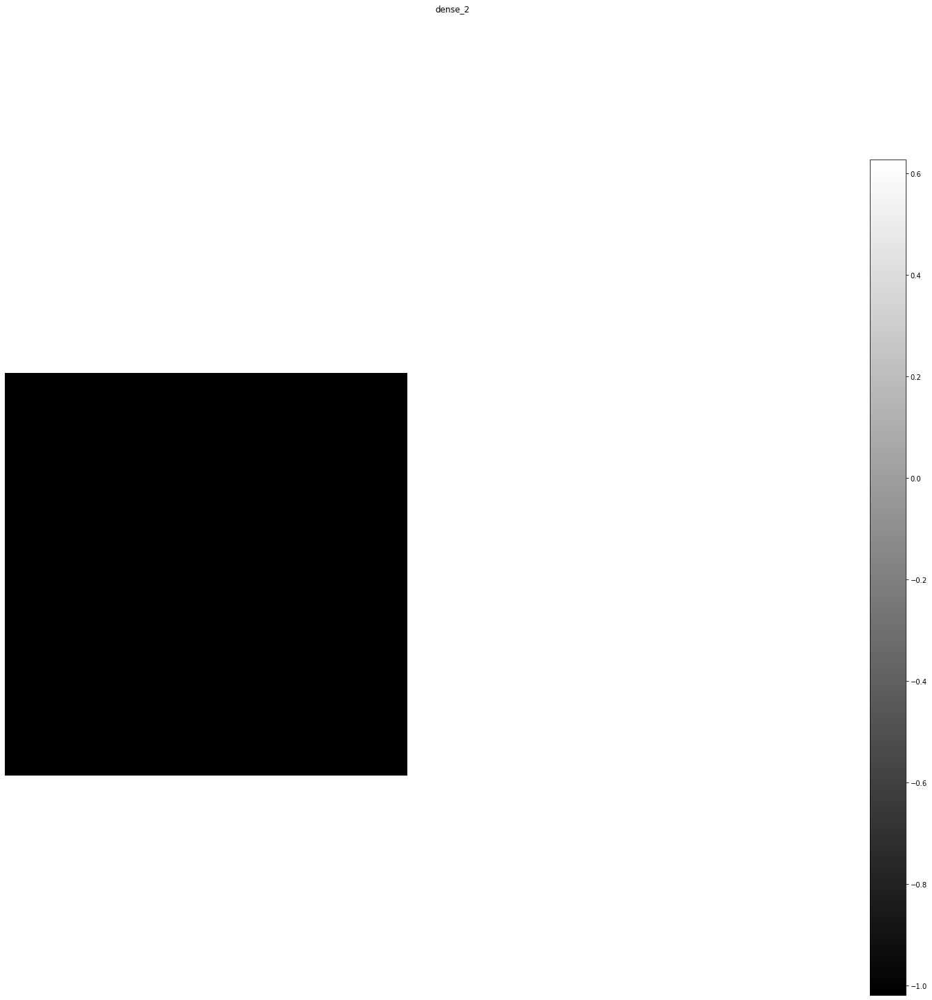

activation (1, 2) 


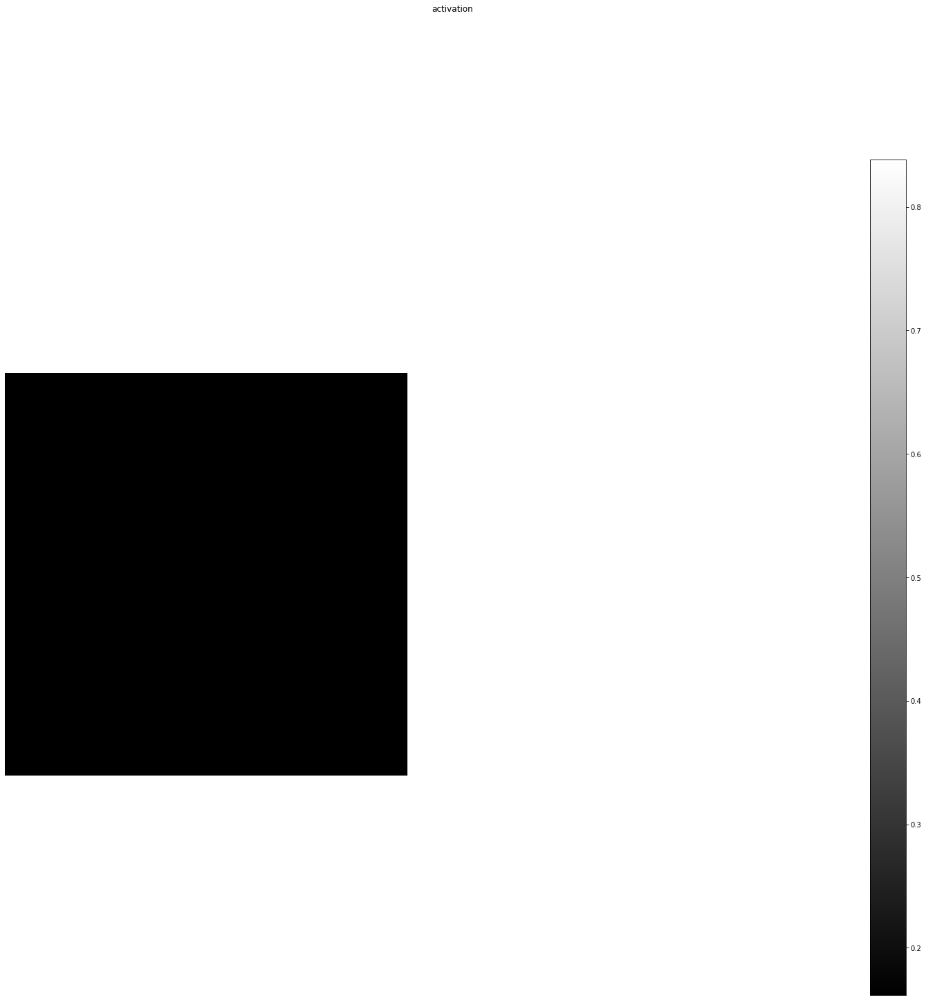

In [ ]:
display_activations(activation_output, cmap="gray", save=False)

conv2d_input (1, 224, 224, 3) 


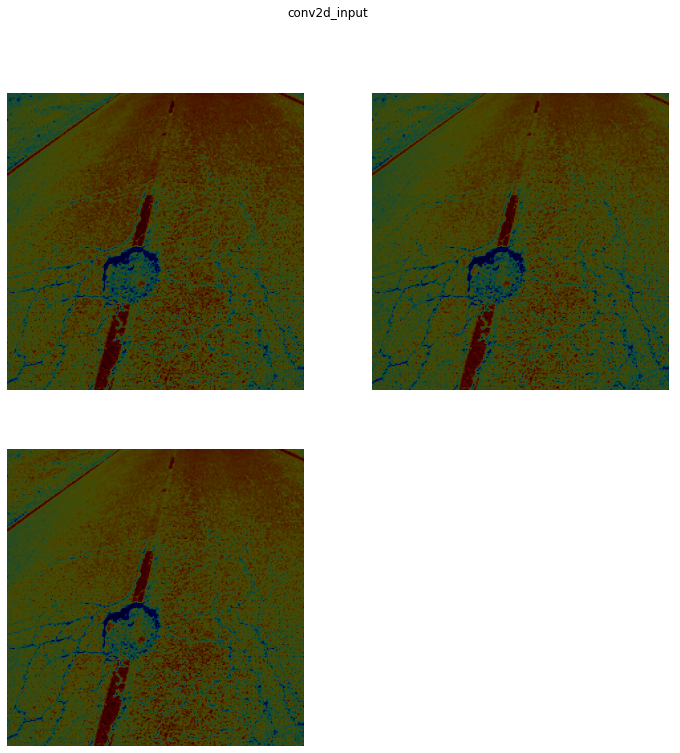

conv2d (1, 224, 224, 32) 


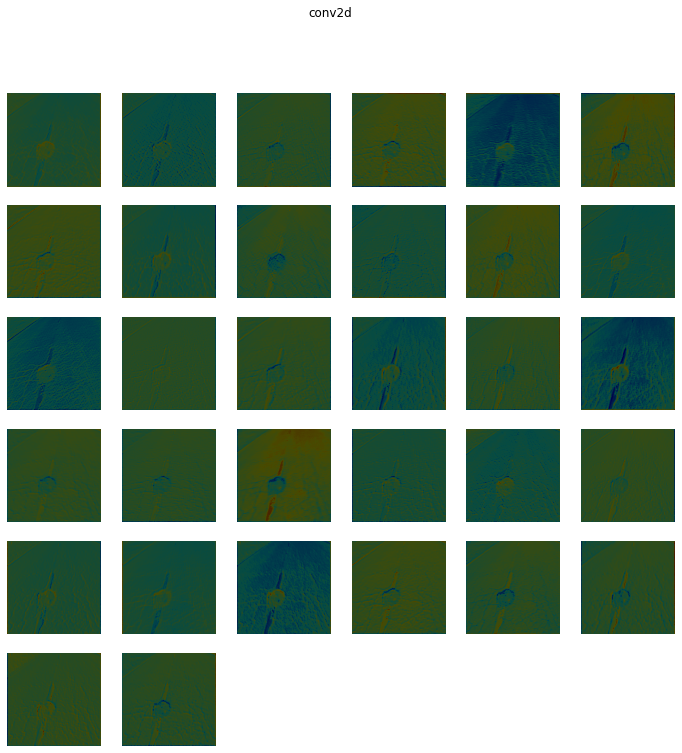

conv2d_1 (1, 224, 224, 32) 


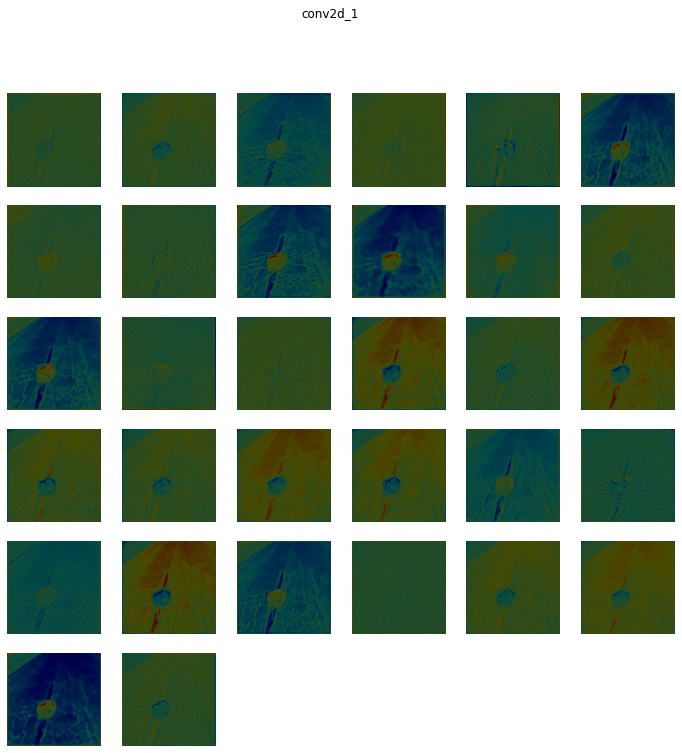

max_pooling2d (1, 112, 112, 32) 


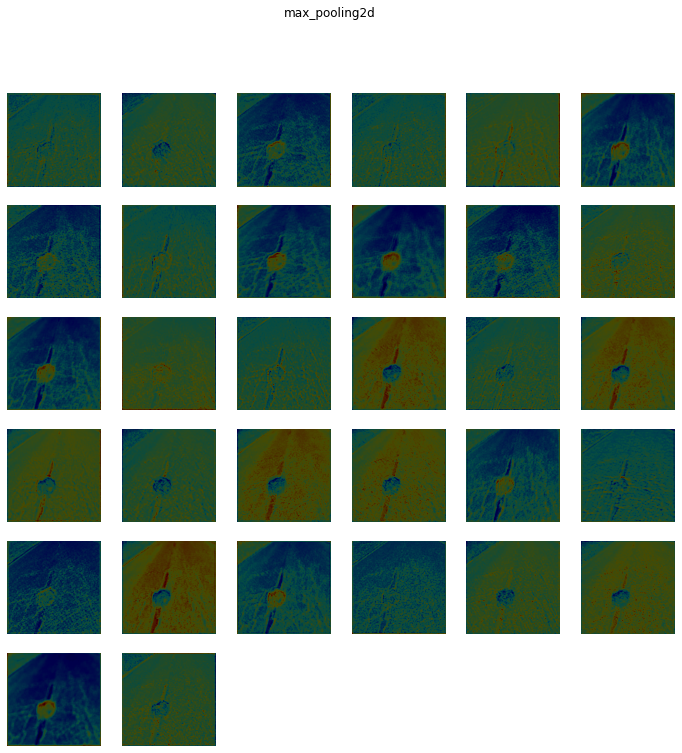

conv2d_2 (1, 112, 112, 64) 


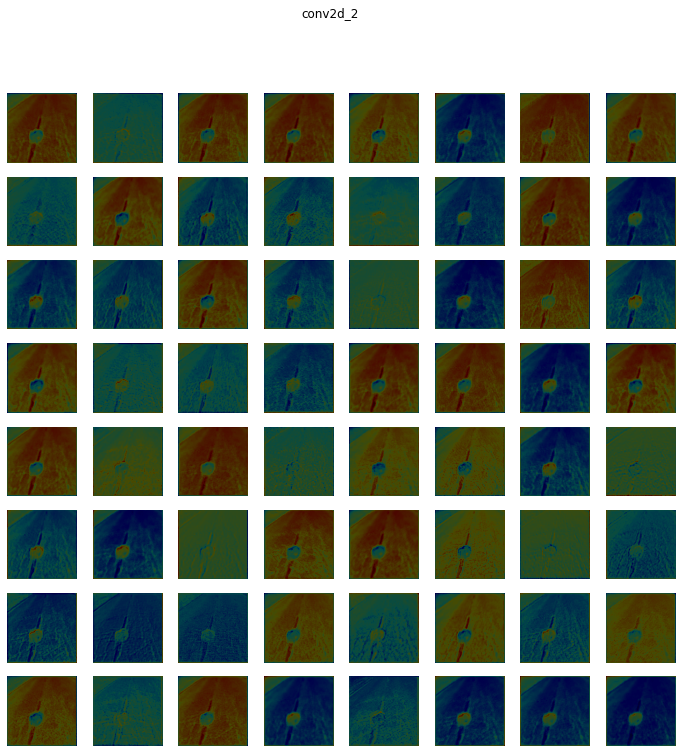

conv2d_3 (1, 112, 112, 64) 


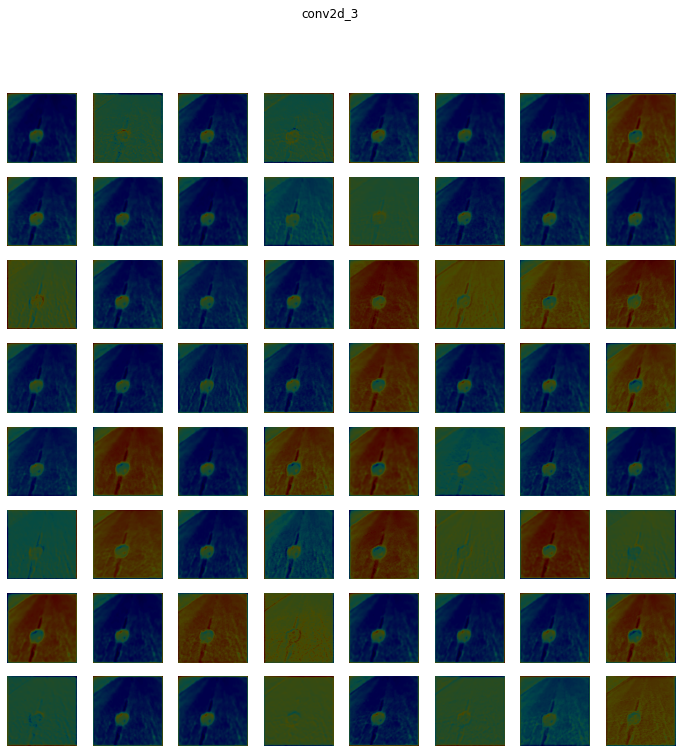

max_pooling2d_1 (1, 56, 56, 64) 


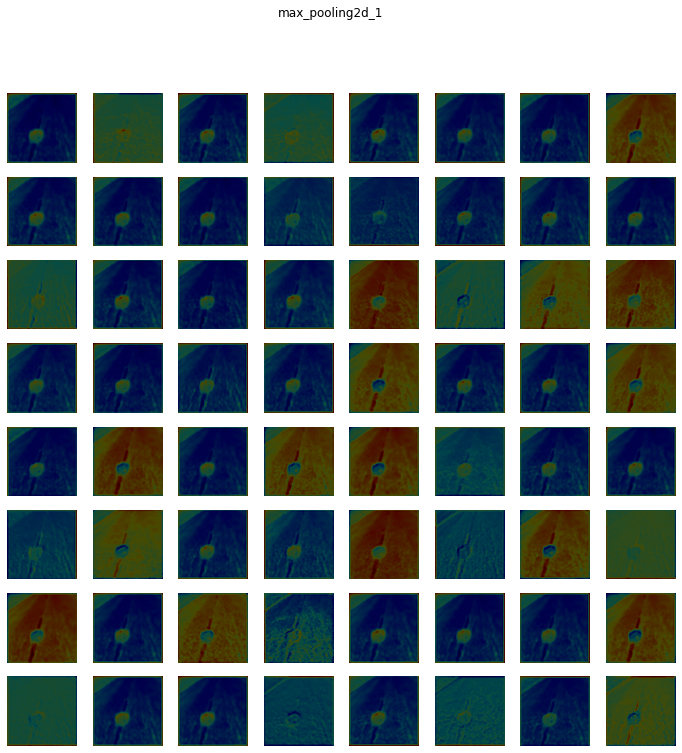

conv2d_4 (1, 56, 56, 128) 


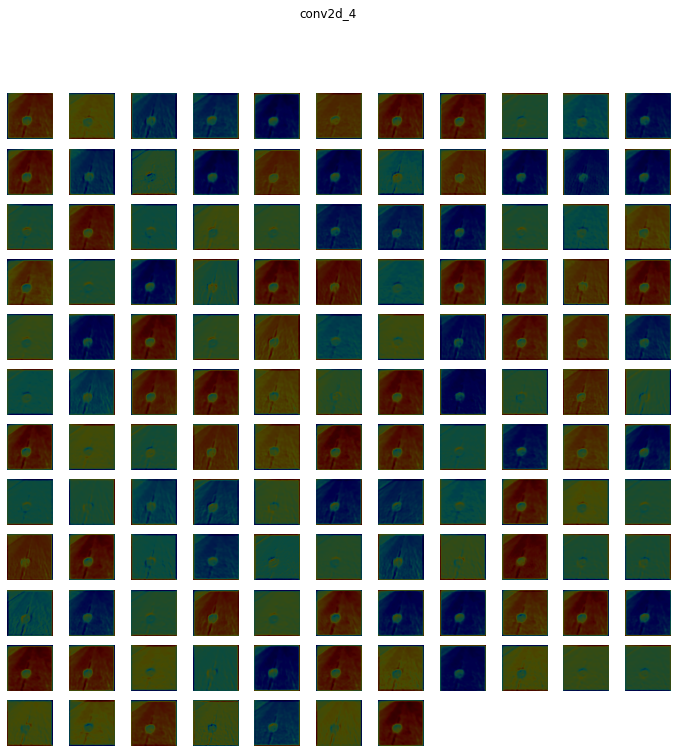

conv2d_5 (1, 56, 56, 128) 


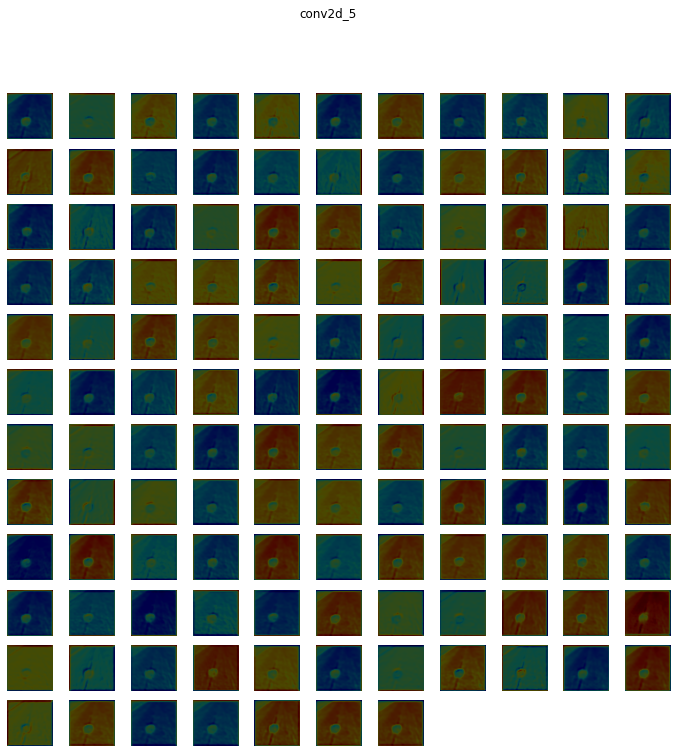

conv2d_6 (1, 56, 56, 128) 


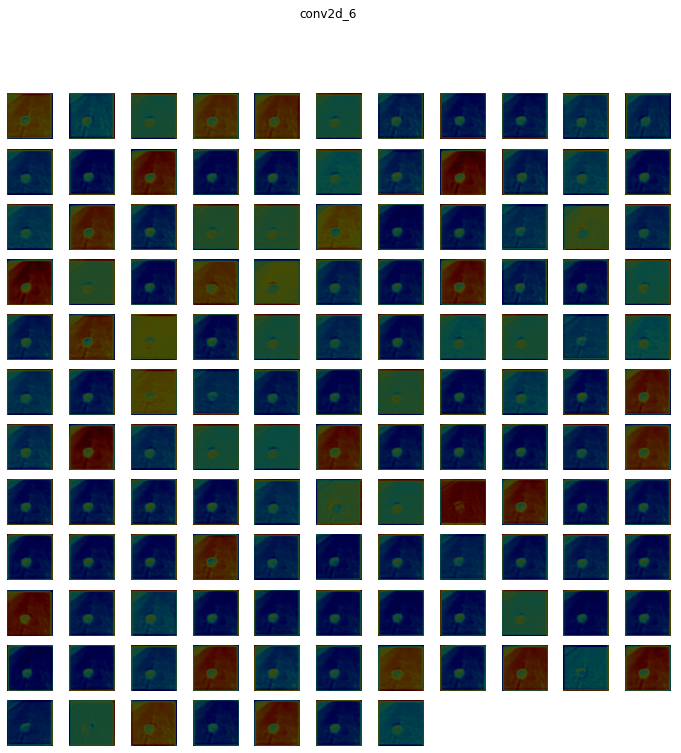

max_pooling2d_2 (1, 28, 28, 128) 


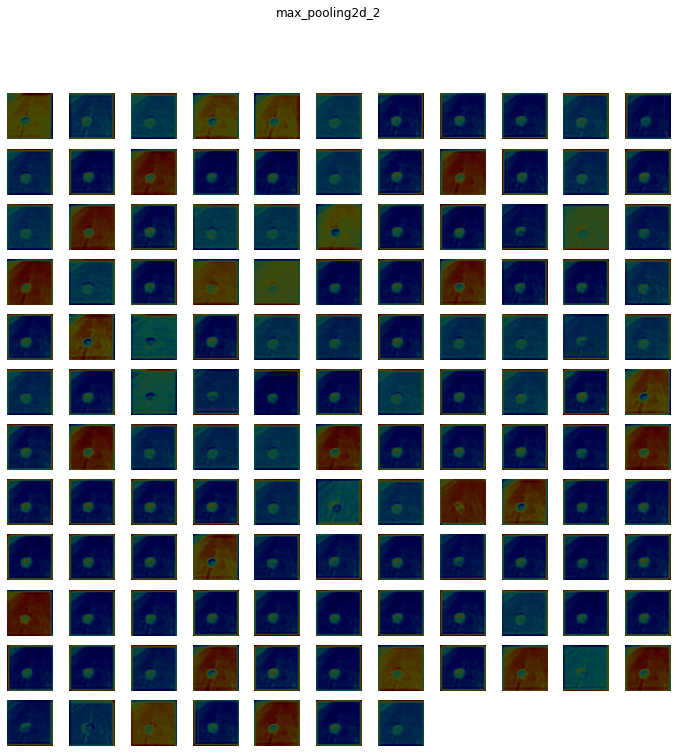

conv2d_7 (1, 28, 28, 128) 


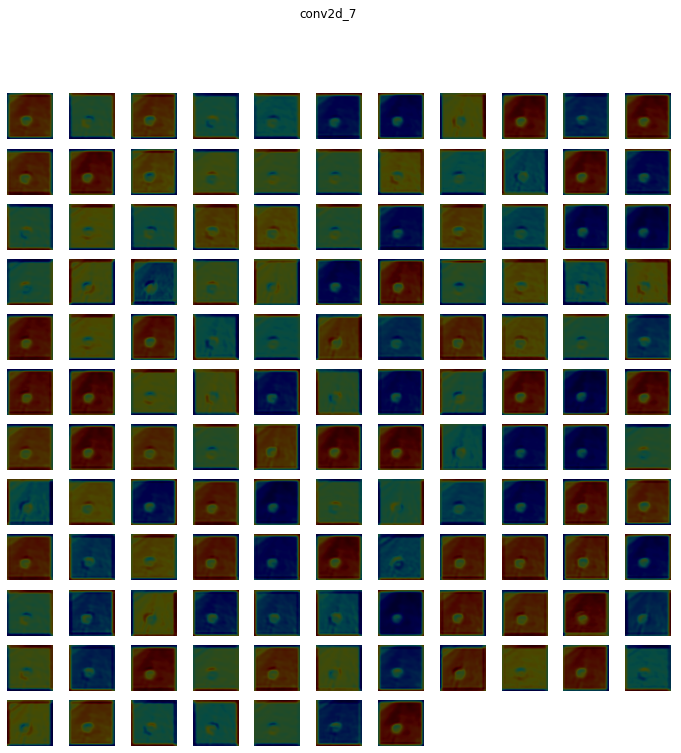

conv2d_8 (1, 28, 28, 128) 


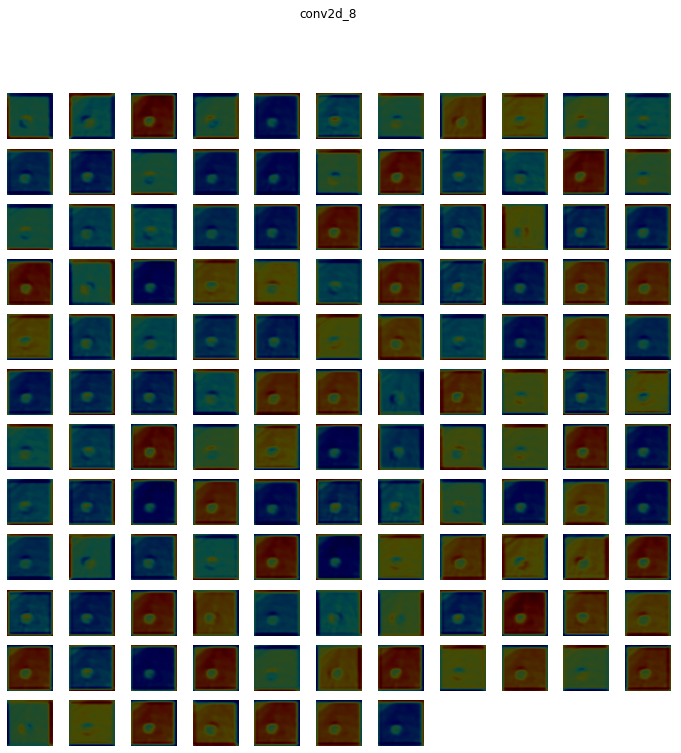

conv2d_9 (1, 28, 28, 128) 


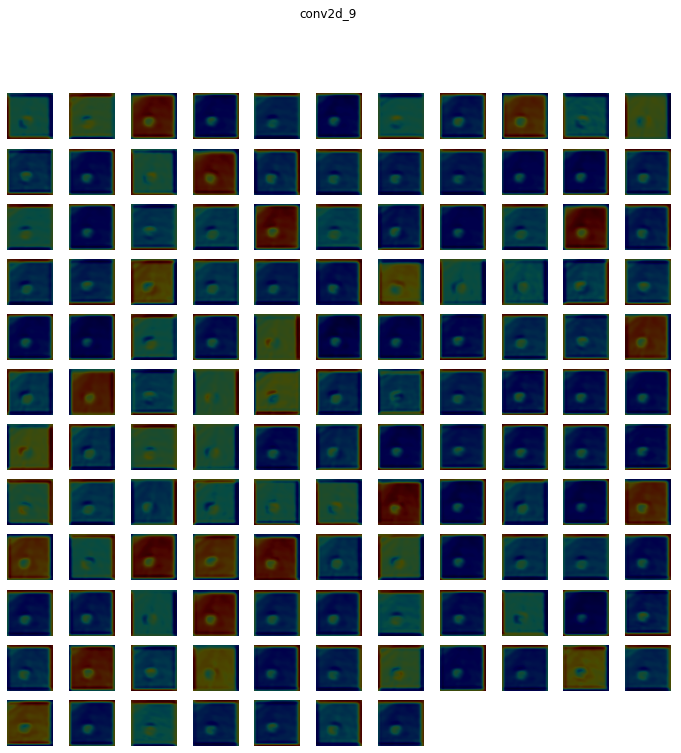

max_pooling2d_3 (1, 14, 14, 128) 


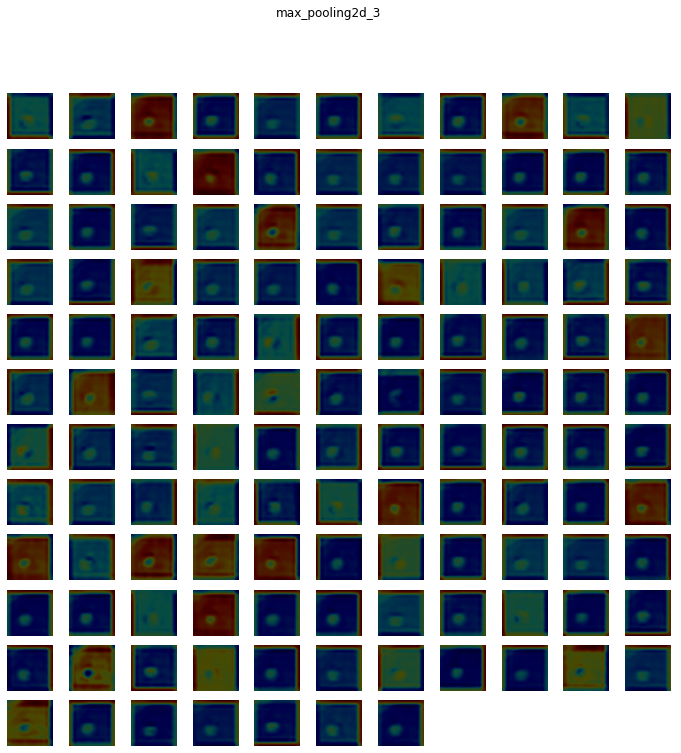

conv2d_10 (1, 14, 14, 128) 


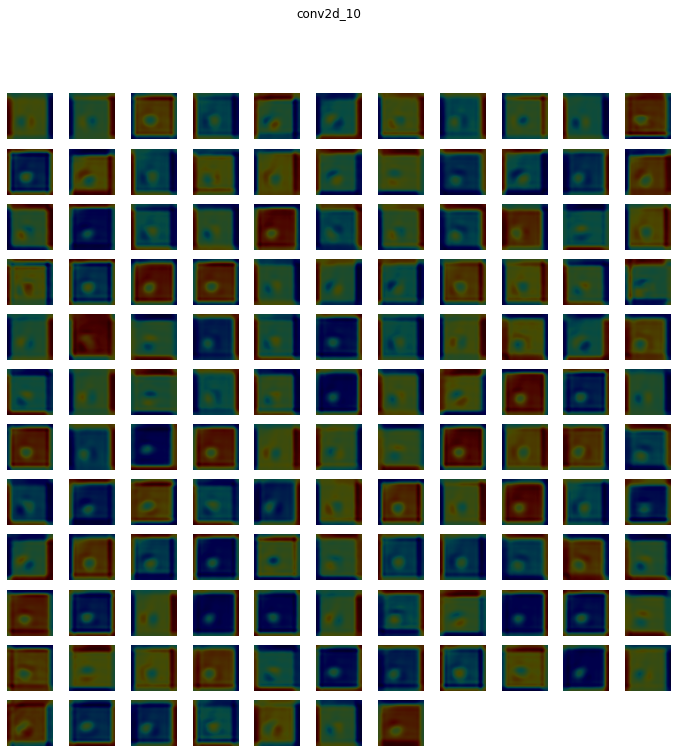

conv2d_11 (1, 14, 14, 128) 


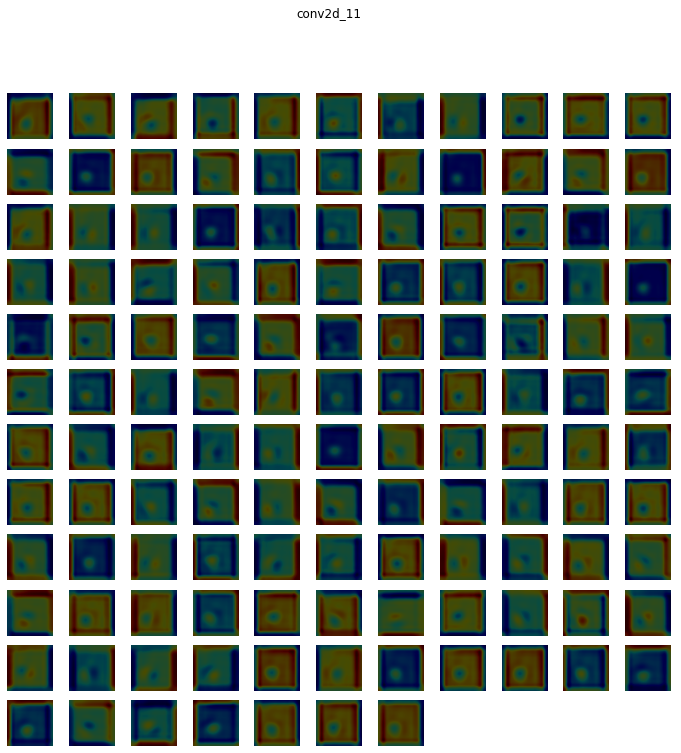

conv2d_12 (1, 14, 14, 128) 


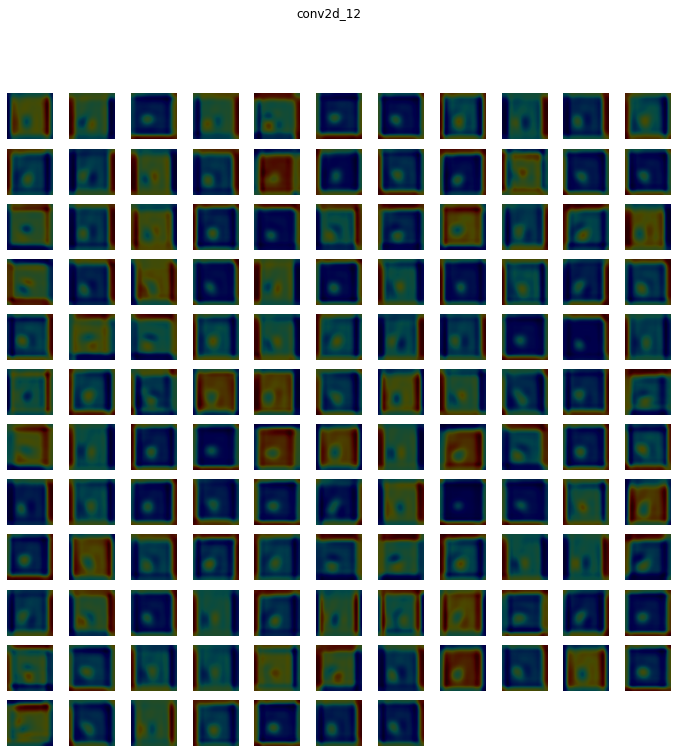

max_pooling2d_4 (1, 7, 7, 128) 


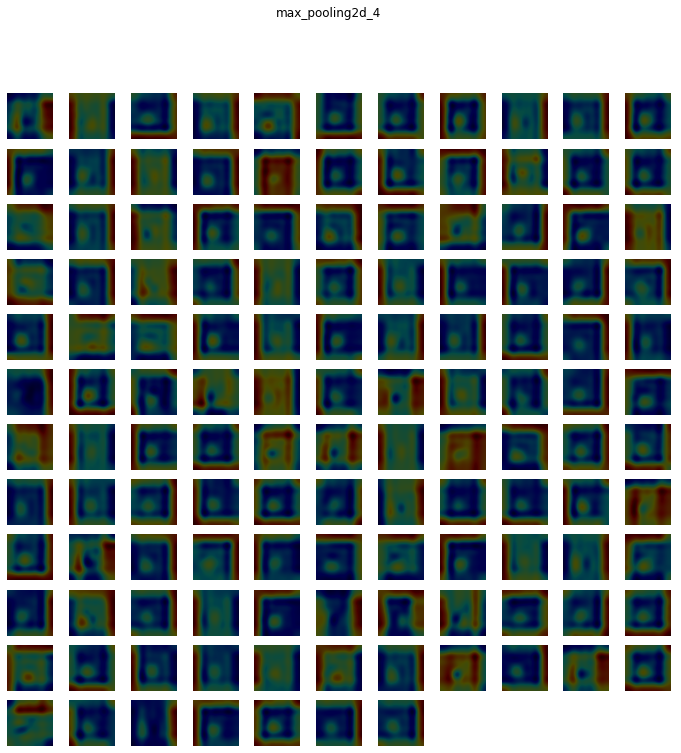

flatten (1, 6272) -> Skipped. 2D Activations.
dropout (1, 6272) -> Skipped. 2D Activations.
dense (1, 128) -> Skipped. 2D Activations.
dense_1 (1, 128) -> Skipped. 2D Activations.
dense_2 (1, 2) -> Skipped. 2D Activations.
activation (1, 2) -> Skipped. 2D Activations.


In [ ]:
display_heatmaps(activation_output, test_input, save=False)